# Session (466029_f3_stage2_day5)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "466029_f3_stage2_day5" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "466029_f3"
day = "day5"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35125, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


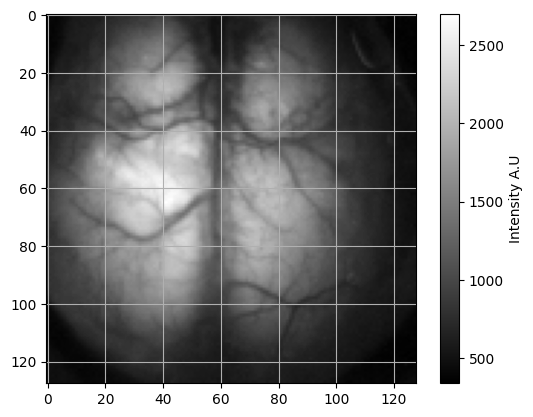

frame number 6000 plotted


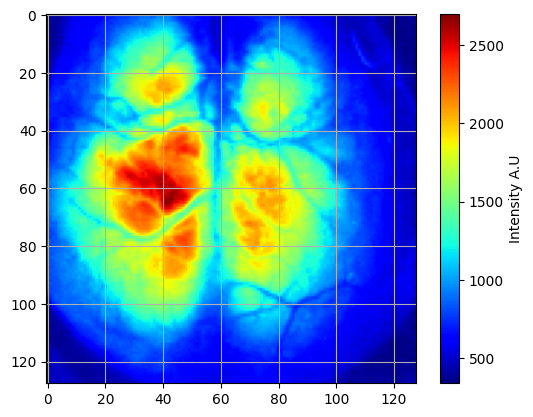

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 366.4760009765625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 412.28550109863284


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 80
Number of double_flash pairs: 40
Number of single_flash: 34
Number of total flashes: 114


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/114 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/114 [00:01<02:39,  1.41s/it]

  2%|█▍                                                                                | 2/114 [00:02<02:32,  1.36s/it]

  3%|██▏                                                                               | 3/114 [00:04<02:28,  1.34s/it]

  4%|██▉                                                                               | 4/114 [00:05<02:23,  1.31s/it]

  4%|███▌                                                                              | 5/114 [00:06<02:24,  1.32s/it]

  5%|████▎                                                                             | 6/114 [00:08<02:24,  1.33s/it]

  6%|█████                                                                             | 7/114 [00:09<02:23,  1.34s/it]

  7%|█████▊                                                                            | 8/114 [00:10<02:24,  1.36s/it]

  8%|██████▍                                                                           | 9/114 [00:12<02:23,  1.37s/it]

  9%|███████                                                                          | 10/114 [00:13<02:25,  1.40s/it]

 10%|███████▊                                                                         | 11/114 [00:14<02:21,  1.38s/it]

 11%|████████▌                                                                        | 12/114 [00:16<02:20,  1.38s/it]

 11%|█████████▏                                                                       | 13/114 [00:17<02:18,  1.37s/it]

 12%|█████████▉                                                                       | 14/114 [00:19<02:17,  1.38s/it]

 13%|██████████▋                                                                      | 15/114 [00:20<02:20,  1.42s/it]

 14%|███████████▎                                                                     | 16/114 [00:22<02:29,  1.53s/it]

 15%|████████████                                                                     | 17/114 [00:23<02:26,  1.51s/it]

 16%|████████████▊                                                                    | 18/114 [00:25<02:23,  1.50s/it]

 17%|█████████████▌                                                                   | 19/114 [00:26<02:19,  1.47s/it]

 18%|██████████████▏                                                                  | 20/114 [00:28<02:20,  1.49s/it]

 18%|██████████████▉                                                                  | 21/114 [00:29<02:19,  1.50s/it]

 19%|███████████████▋                                                                 | 22/114 [00:31<02:17,  1.49s/it]

 20%|████████████████▎                                                                | 23/114 [00:32<02:19,  1.54s/it]

 21%|█████████████████                                                                | 24/114 [00:34<02:16,  1.51s/it]

 22%|█████████████████▊                                                               | 25/114 [00:35<02:17,  1.54s/it]

 23%|██████████████████▍                                                              | 26/114 [00:37<02:13,  1.52s/it]

 24%|███████████████████▏                                                             | 27/114 [00:38<02:11,  1.51s/it]

 25%|███████████████████▉                                                             | 28/114 [00:40<02:10,  1.52s/it]

 25%|████████████████████▌                                                            | 29/114 [00:42<02:15,  1.59s/it]

 26%|█████████████████████▎                                                           | 30/114 [00:43<02:12,  1.58s/it]

 27%|██████████████████████                                                           | 31/114 [00:45<02:15,  1.63s/it]

 28%|██████████████████████▋                                                          | 32/114 [00:46<02:09,  1.58s/it]

 29%|███████████████████████▍                                                         | 33/114 [00:48<02:08,  1.58s/it]

 30%|████████████████████████▏                                                        | 34/114 [00:50<02:08,  1.61s/it]

 31%|████████████████████████▊                                                        | 35/114 [00:51<02:04,  1.58s/it]

 32%|█████████████████████████▌                                                       | 36/114 [00:53<02:01,  1.56s/it]

 32%|██████████████████████████▎                                                      | 37/114 [00:54<01:58,  1.54s/it]

 33%|███████████████████████████                                                      | 38/114 [00:56<01:53,  1.49s/it]

 34%|███████████████████████████▋                                                     | 39/114 [00:57<01:50,  1.48s/it]

 35%|████████████████████████████▍                                                    | 40/114 [00:59<01:53,  1.53s/it]

 36%|█████████████████████████████▏                                                   | 41/114 [01:00<01:53,  1.55s/it]

 37%|█████████████████████████████▊                                                   | 42/114 [01:02<01:50,  1.54s/it]

 38%|██████████████████████████████▌                                                  | 43/114 [01:03<01:46,  1.50s/it]

 39%|███████████████████████████████▎                                                 | 44/114 [01:05<01:47,  1.54s/it]

 39%|███████████████████████████████▉                                                 | 45/114 [01:06<01:47,  1.55s/it]

 40%|████████████████████████████████▋                                                | 46/114 [01:08<01:45,  1.56s/it]

 41%|█████████████████████████████████▍                                               | 47/114 [01:10<01:43,  1.54s/it]

 42%|██████████████████████████████████                                               | 48/114 [01:11<01:44,  1.58s/it]

 43%|██████████████████████████████████▊                                              | 49/114 [01:13<01:45,  1.62s/it]

 44%|███████████████████████████████████▌                                             | 50/114 [01:15<01:45,  1.65s/it]

 45%|████████████████████████████████████▏                                            | 51/114 [01:16<01:40,  1.59s/it]

 46%|████████████████████████████████████▉                                            | 52/114 [01:18<01:36,  1.56s/it]

 46%|█████████████████████████████████████▋                                           | 53/114 [01:19<01:32,  1.52s/it]

 47%|██████████████████████████████████████▎                                          | 54/114 [01:21<01:31,  1.53s/it]

 48%|███████████████████████████████████████                                          | 55/114 [01:22<01:29,  1.52s/it]

 49%|███████████████████████████████████████▊                                         | 56/114 [01:24<01:26,  1.50s/it]

 50%|████████████████████████████████████████▌                                        | 57/114 [01:25<01:23,  1.46s/it]

 51%|█████████████████████████████████████████▏                                       | 58/114 [01:26<01:21,  1.46s/it]

 52%|█████████████████████████████████████████▉                                       | 59/114 [01:28<01:19,  1.45s/it]

 53%|██████████████████████████████████████████▋                                      | 60/114 [01:29<01:17,  1.44s/it]

 54%|███████████████████████████████████████████▎                                     | 61/114 [01:31<01:15,  1.42s/it]

 54%|████████████████████████████████████████████                                     | 62/114 [01:32<01:10,  1.36s/it]

 55%|████████████████████████████████████████████▊                                    | 63/114 [01:33<01:09,  1.36s/it]

 56%|█████████████████████████████████████████████▍                                   | 64/114 [01:35<01:08,  1.37s/it]

 57%|██████████████████████████████████████████████▏                                  | 65/114 [01:36<01:08,  1.39s/it]

 58%|██████████████████████████████████████████████▉                                  | 66/114 [01:37<01:08,  1.42s/it]

 59%|███████████████████████████████████████████████▌                                 | 67/114 [01:39<01:06,  1.41s/it]

 60%|████████████████████████████████████████████████▎                                | 68/114 [01:40<01:05,  1.42s/it]

 61%|█████████████████████████████████████████████████                                | 69/114 [01:42<01:03,  1.41s/it]

 61%|█████████████████████████████████████████████████▋                               | 70/114 [01:43<01:00,  1.37s/it]

 62%|██████████████████████████████████████████████████▍                              | 71/114 [01:44<00:58,  1.37s/it]

 63%|███████████████████████████████████████████████████▏                             | 72/114 [01:46<00:56,  1.34s/it]

 64%|███████████████████████████████████████████████████▊                             | 73/114 [01:47<00:54,  1.34s/it]

 65%|████████████████████████████████████████████████████▌                            | 74/114 [01:48<00:54,  1.36s/it]

 66%|█████████████████████████████████████████████████████▎                           | 75/114 [01:50<00:53,  1.38s/it]

 67%|██████████████████████████████████████████████████████                           | 76/114 [01:51<00:52,  1.37s/it]

 68%|██████████████████████████████████████████████████████▋                          | 77/114 [01:52<00:50,  1.37s/it]

 68%|███████████████████████████████████████████████████████▍                         | 78/114 [01:54<00:49,  1.38s/it]

 69%|████████████████████████████████████████████████████████▏                        | 79/114 [01:55<00:48,  1.38s/it]

 70%|████████████████████████████████████████████████████████▊                        | 80/114 [01:57<00:47,  1.39s/it]

 71%|█████████████████████████████████████████████████████████▌                       | 81/114 [01:58<00:45,  1.39s/it]

 72%|██████████████████████████████████████████████████████████▎                      | 82/114 [01:59<00:44,  1.38s/it]

 73%|██████████████████████████████████████████████████████████▉                      | 83/114 [02:01<00:42,  1.36s/it]

 74%|███████████████████████████████████████████████████████████▋                     | 84/114 [02:02<00:39,  1.31s/it]

 75%|████████████████████████████████████████████████████████████▍                    | 85/114 [02:03<00:38,  1.31s/it]

 75%|█████████████████████████████████████████████████████████████                    | 86/114 [02:05<00:36,  1.30s/it]

 76%|█████████████████████████████████████████████████████████████▊                   | 87/114 [02:06<00:35,  1.31s/it]

 77%|██████████████████████████████████████████████████████████████▌                  | 88/114 [02:07<00:34,  1.33s/it]

 78%|███████████████████████████████████████████████████████████████▏                 | 89/114 [02:09<00:33,  1.35s/it]

 79%|███████████████████████████████████████████████████████████████▉                 | 90/114 [02:10<00:32,  1.34s/it]

 80%|████████████████████████████████████████████████████████████████▋                | 91/114 [02:11<00:30,  1.34s/it]

 81%|█████████████████████████████████████████████████████████████████▎               | 92/114 [02:13<00:29,  1.34s/it]

 82%|██████████████████████████████████████████████████████████████████               | 93/114 [02:14<00:28,  1.34s/it]

 82%|██████████████████████████████████████████████████████████████████▊              | 94/114 [02:15<00:27,  1.36s/it]

 83%|███████████████████████████████████████████████████████████████████▌             | 95/114 [02:17<00:26,  1.39s/it]

 84%|████████████████████████████████████████████████████████████████████▏            | 96/114 [02:18<00:25,  1.40s/it]

 85%|████████████████████████████████████████████████████████████████████▉            | 97/114 [02:20<00:23,  1.40s/it]

 86%|█████████████████████████████████████████████████████████████████████▋           | 98/114 [02:21<00:22,  1.39s/it]

 87%|██████████████████████████████████████████████████████████████████████▎          | 99/114 [02:22<00:20,  1.37s/it]

 88%|██████████████████████████████████████████████████████████████████████▏         | 100/114 [02:24<00:19,  1.37s/it]

 89%|██████████████████████████████████████████████████████████████████████▉         | 101/114 [02:25<00:17,  1.38s/it]

 89%|███████████████████████████████████████████████████████████████████████▌        | 102/114 [02:26<00:16,  1.38s/it]

 90%|████████████████████████████████████████████████████████████████████████▎       | 103/114 [02:28<00:15,  1.38s/it]

 91%|████████████████████████████████████████████████████████████████████████▉       | 104/114 [02:29<00:13,  1.39s/it]

 92%|█████████████████████████████████████████████████████████████████████████▋      | 105/114 [02:31<00:12,  1.38s/it]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 106/114 [02:32<00:10,  1.34s/it]

 94%|███████████████████████████████████████████████████████████████████████████     | 107/114 [02:33<00:09,  1.33s/it]

 95%|███████████████████████████████████████████████████████████████████████████▊    | 108/114 [02:35<00:08,  1.35s/it]

 96%|████████████████████████████████████████████████████████████████████████████▍   | 109/114 [02:36<00:06,  1.35s/it]

 96%|█████████████████████████████████████████████████████████████████████████████▏  | 110/114 [02:37<00:05,  1.38s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▉  | 111/114 [02:39<00:04,  1.37s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▌ | 112/114 [02:40<00:02,  1.38s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 113/114 [02:42<00:01,  1.38s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 114/114 [02:43<00:00,  1.37s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 114/114 [02:43<00:00,  1.43s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 23%|██████████████████▏                                                             | 29/128 [00:00<00:00, 271.12it/s]

 45%|████████████████████████████████████▎                                           | 58/128 [00:00<00:00, 277.22it/s]

 67%|█████████████████████████████████████████████████████▊                          | 86/128 [00:00<00:00, 274.83it/s]

 91%|███████████████████████████████████████████████████████████████████████▌       | 116/128 [00:00<00:00, 280.25it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 277.75it/s]

  0%|                                                                                        | 0/34362 [00:00<?, ?it/s]

  0%|                                                                              | 30/34362 [00:00<01:57, 292.75it/s]

  0%|▏                                                                             | 60/34362 [00:00<02:49, 202.65it/s]

  0%|▏                                                                             | 82/34362 [00:00<02:47, 205.24it/s]

  0%|▏                                                                            | 106/34362 [00:00<02:38, 216.25it/s]

  0%|▎                                                                            | 134/34362 [00:00<02:25, 235.42it/s]

  0%|▎                                                                            | 164/34362 [00:00<02:15, 252.62it/s]

  1%|▍                                                                            | 190/34362 [00:00<02:19, 245.47it/s]

  1%|▍                                                                            | 215/34362 [00:00<02:24, 236.97it/s]

  1%|▌                                                                            | 242/34362 [00:01<02:18, 245.86it/s]

  1%|▌                                                                            | 270/34362 [00:01<02:14, 254.37it/s]

  1%|▋                                                                            | 296/34362 [00:01<02:16, 249.53it/s]

  1%|▋                                                                            | 325/34362 [00:01<02:10, 260.40it/s]

  1%|▊                                                                            | 352/34362 [00:01<02:11, 257.79it/s]

  1%|▊                                                                            | 380/34362 [00:01<02:08, 264.12it/s]

  1%|▉                                                                            | 407/34362 [00:01<02:13, 253.97it/s]

  1%|▉                                                                            | 436/34362 [00:01<02:10, 260.93it/s]

  1%|█                                                                            | 464/34362 [00:01<02:07, 265.67it/s]

  1%|█                                                                            | 491/34362 [00:01<02:09, 260.89it/s]

  2%|█▏                                                                           | 518/34362 [00:02<02:16, 248.16it/s]

  2%|█▏                                                                           | 545/34362 [00:02<02:13, 252.87it/s]

  2%|█▎                                                                           | 573/34362 [00:02<02:10, 258.41it/s]

  2%|█▎                                                                           | 599/34362 [00:02<02:15, 248.89it/s]

  2%|█▍                                                                           | 625/34362 [00:02<02:22, 236.97it/s]

  2%|█▍                                                                           | 649/34362 [00:02<02:24, 233.97it/s]

  2%|█▌                                                                           | 674/34362 [00:02<02:22, 235.83it/s]

  2%|█▌                                                                           | 701/34362 [00:02<02:19, 241.42it/s]

  2%|█▋                                                                           | 728/34362 [00:02<02:15, 248.86it/s]

  2%|█▋                                                                           | 753/34362 [00:03<02:16, 247.08it/s]

  2%|█▋                                                                           | 780/34362 [00:03<02:12, 253.02it/s]

  2%|█▊                                                                           | 806/34362 [00:03<02:11, 254.34it/s]

  2%|█▊                                                                           | 834/34362 [00:03<02:08, 260.38it/s]

  3%|█▉                                                                           | 861/34362 [00:03<02:08, 260.93it/s]

  3%|█▉                                                                           | 888/34362 [00:03<02:12, 252.48it/s]

  3%|██                                                                           | 914/34362 [00:03<02:15, 246.19it/s]

  3%|██                                                                           | 942/34362 [00:03<02:11, 254.37it/s]

  3%|██▏                                                                          | 968/34362 [00:03<02:18, 240.79it/s]

  3%|██▏                                                                          | 997/34362 [00:04<02:11, 253.82it/s]

  3%|██▎                                                                         | 1025/34362 [00:04<02:09, 256.90it/s]

  3%|██▎                                                                         | 1051/34362 [00:04<02:22, 234.48it/s]

  3%|██▍                                                                         | 1075/34362 [00:04<02:23, 232.22it/s]

  3%|██▍                                                                         | 1100/34362 [00:04<02:21, 234.78it/s]

  3%|██▍                                                                         | 1124/34362 [00:04<02:24, 230.33it/s]

  3%|██▌                                                                         | 1152/34362 [00:04<02:17, 242.27it/s]

  3%|██▌                                                                         | 1180/34362 [00:04<02:12, 250.18it/s]

  4%|██▋                                                                         | 1207/34362 [00:04<02:10, 254.43it/s]

  4%|██▋                                                                         | 1235/34362 [00:04<02:07, 259.61it/s]

  4%|██▊                                                                         | 1262/34362 [00:05<02:06, 261.89it/s]

  4%|██▊                                                                         | 1290/34362 [00:05<02:04, 264.90it/s]

  4%|██▉                                                                         | 1318/34362 [00:05<02:03, 267.78it/s]

  4%|██▉                                                                         | 1346/34362 [00:05<02:02, 269.03it/s]

  4%|███                                                                         | 1373/34362 [00:05<02:03, 267.77it/s]

  4%|███                                                                         | 1400/34362 [00:05<02:05, 262.27it/s]

  4%|███▏                                                                        | 1427/34362 [00:05<02:04, 263.78it/s]

  4%|███▏                                                                        | 1454/34362 [00:05<02:09, 254.44it/s]

  4%|███▎                                                                        | 1480/34362 [00:05<02:10, 252.44it/s]

  4%|███▎                                                                        | 1508/34362 [00:06<02:06, 258.90it/s]

  4%|███▍                                                                        | 1535/34362 [00:06<02:05, 260.64it/s]

  5%|███▍                                                                        | 1563/34362 [00:06<02:04, 264.00it/s]

  5%|███▌                                                                        | 1590/34362 [00:06<02:06, 259.71it/s]

  5%|███▌                                                                        | 1617/34362 [00:06<02:06, 258.23it/s]

  5%|███▋                                                                        | 1646/34362 [00:06<02:03, 265.15it/s]

  5%|███▋                                                                        | 1673/34362 [00:06<02:09, 252.63it/s]

  5%|███▊                                                                        | 1700/34362 [00:06<02:07, 255.40it/s]

  5%|███▊                                                                        | 1726/34362 [00:06<02:08, 253.12it/s]

  5%|███▉                                                                        | 1754/34362 [00:06<02:06, 257.90it/s]

  5%|███▉                                                                        | 1782/34362 [00:07<02:04, 261.29it/s]

  5%|████                                                                        | 1809/34362 [00:07<02:04, 260.82it/s]

  5%|████                                                                        | 1836/34362 [00:07<02:06, 256.95it/s]

  5%|████                                                                        | 1862/34362 [00:07<02:07, 254.17it/s]

  5%|████▏                                                                       | 1889/34362 [00:07<02:06, 257.28it/s]

  6%|████▏                                                                       | 1915/34362 [00:07<02:15, 239.31it/s]

  6%|████▎                                                                       | 1941/34362 [00:07<02:13, 243.73it/s]

  6%|████▎                                                                       | 1968/34362 [00:07<02:09, 249.78it/s]

  6%|████▍                                                                       | 1994/34362 [00:07<02:11, 247.07it/s]

  6%|████▍                                                                       | 2022/34362 [00:08<02:06, 255.05it/s]

  6%|████▌                                                                       | 2049/34362 [00:08<02:05, 256.80it/s]

  6%|████▌                                                                       | 2076/34362 [00:08<02:04, 259.15it/s]

  6%|████▋                                                                       | 2106/34362 [00:08<02:00, 268.75it/s]

  6%|████▋                                                                       | 2133/34362 [00:08<02:00, 266.61it/s]

  6%|████▊                                                                       | 2160/34362 [00:08<02:02, 263.01it/s]

  6%|████▊                                                                       | 2188/34362 [00:08<02:01, 265.66it/s]

  6%|████▉                                                                       | 2215/34362 [00:08<02:00, 266.18it/s]

  7%|████▉                                                                       | 2242/34362 [00:08<02:04, 257.50it/s]

  7%|█████                                                                       | 2268/34362 [00:08<02:05, 255.30it/s]

  7%|█████                                                                       | 2296/34362 [00:09<02:03, 260.21it/s]

  7%|█████▏                                                                      | 2323/34362 [00:09<02:03, 260.06it/s]

  7%|█████▏                                                                      | 2350/34362 [00:09<02:02, 260.70it/s]

  7%|█████▎                                                                      | 2377/34362 [00:09<02:07, 250.99it/s]

  7%|█████▎                                                                      | 2405/34362 [00:09<02:03, 257.80it/s]

  7%|█████▍                                                                      | 2434/34362 [00:09<02:00, 264.05it/s]

  7%|█████▍                                                                      | 2461/34362 [00:09<02:11, 242.03it/s]

  7%|█████▍                                                                      | 2486/34362 [00:09<02:12, 240.94it/s]

  7%|█████▌                                                                      | 2511/34362 [00:09<02:14, 236.90it/s]

  7%|█████▌                                                                      | 2535/34362 [00:10<02:21, 225.23it/s]

  7%|█████▋                                                                      | 2560/34362 [00:10<02:18, 228.90it/s]

  8%|█████▋                                                                      | 2584/34362 [00:10<02:18, 229.20it/s]

  8%|█████▊                                                                      | 2610/34362 [00:10<02:13, 237.53it/s]

  8%|█████▊                                                                      | 2635/34362 [00:10<02:12, 239.07it/s]

  8%|█████▉                                                                      | 2659/34362 [00:10<02:12, 239.01it/s]

  8%|█████▉                                                                      | 2686/34362 [00:10<02:08, 246.28it/s]

  8%|█████▉                                                                      | 2711/34362 [00:10<02:24, 218.60it/s]

  8%|██████                                                                      | 2738/34362 [00:10<02:16, 231.87it/s]

  8%|██████                                                                      | 2766/34362 [00:11<02:09, 244.23it/s]

  8%|██████▏                                                                     | 2794/34362 [00:11<02:05, 252.25it/s]

  8%|██████▏                                                                     | 2820/34362 [00:11<02:09, 243.34it/s]

  8%|██████▎                                                                     | 2845/34362 [00:11<02:17, 229.14it/s]

  8%|██████▎                                                                     | 2872/34362 [00:11<02:11, 239.66it/s]

  8%|██████▍                                                                     | 2901/34362 [00:11<02:04, 252.36it/s]

  9%|██████▍                                                                     | 2928/34362 [00:11<02:02, 255.95it/s]

  9%|██████▌                                                                     | 2954/34362 [00:11<02:04, 251.35it/s]

  9%|██████▌                                                                     | 2981/34362 [00:11<02:03, 254.54it/s]

  9%|██████▋                                                                     | 3010/34362 [00:12<01:58, 264.01it/s]

  9%|██████▋                                                                     | 3037/34362 [00:12<02:00, 259.02it/s]

  9%|██████▊                                                                     | 3064/34362 [00:12<01:59, 261.46it/s]

  9%|██████▊                                                                     | 3091/34362 [00:12<02:01, 257.96it/s]

  9%|██████▉                                                                     | 3118/34362 [00:12<02:00, 259.22it/s]

  9%|██████▉                                                                     | 3144/34362 [00:12<02:00, 258.72it/s]

  9%|███████                                                                     | 3170/34362 [00:12<02:09, 240.80it/s]

  9%|███████                                                                     | 3195/34362 [00:12<02:10, 238.72it/s]

  9%|███████▏                                                                    | 3222/34362 [00:12<02:06, 245.48it/s]

  9%|███████▏                                                                    | 3248/34362 [00:12<02:05, 248.23it/s]

 10%|███████▏                                                                    | 3277/34362 [00:13<02:00, 258.81it/s]

 10%|███████▎                                                                    | 3303/34362 [00:13<02:05, 248.36it/s]

 10%|███████▎                                                                    | 3330/34362 [00:13<02:02, 253.82it/s]

 10%|███████▍                                                                    | 3359/34362 [00:13<01:57, 263.02it/s]

 10%|███████▍                                                                    | 3387/34362 [00:13<01:55, 267.07it/s]

 10%|███████▌                                                                    | 3414/34362 [00:13<02:06, 245.00it/s]

 10%|███████▌                                                                    | 3439/34362 [00:13<02:10, 237.22it/s]

 10%|███████▋                                                                    | 3464/34362 [00:13<02:15, 228.19it/s]

 10%|███████▋                                                                    | 3493/34362 [00:13<02:06, 243.62it/s]

 10%|███████▊                                                                    | 3520/34362 [00:14<02:03, 249.67it/s]

 10%|███████▊                                                                    | 3549/34362 [00:14<01:58, 260.40it/s]

 10%|███████▉                                                                    | 3576/34362 [00:14<02:01, 253.70it/s]

 10%|███████▉                                                                    | 3602/34362 [00:14<02:06, 243.75it/s]

 11%|████████                                                                    | 3632/34362 [00:14<01:59, 256.60it/s]

 11%|████████                                                                    | 3658/34362 [00:14<01:59, 256.14it/s]

 11%|████████▏                                                                   | 3687/34362 [00:14<01:55, 264.72it/s]

 11%|████████▏                                                                   | 3716/34362 [00:14<01:52, 271.67it/s]

 11%|████████▎                                                                   | 3744/34362 [00:14<01:55, 264.84it/s]

 11%|████████▎                                                                   | 3772/34362 [00:15<01:54, 266.93it/s]

 11%|████████▍                                                                   | 3799/34362 [00:15<01:57, 259.58it/s]

 11%|████████▍                                                                   | 3826/34362 [00:15<02:02, 249.05it/s]

 11%|████████▌                                                                   | 3852/34362 [00:15<02:08, 237.54it/s]

 11%|████████▌                                                                   | 3878/34362 [00:15<02:06, 241.72it/s]

 11%|████████▋                                                                   | 3905/34362 [00:15<02:03, 246.20it/s]

 11%|████████▋                                                                   | 3930/34362 [00:15<02:03, 245.91it/s]

 12%|████████▋                                                                   | 3955/34362 [00:15<02:06, 240.56it/s]

 12%|████████▊                                                                   | 3980/34362 [00:15<02:08, 235.88it/s]

 12%|████████▊                                                                   | 4006/34362 [00:15<02:07, 238.68it/s]

 12%|████████▉                                                                   | 4034/34362 [00:16<02:03, 246.25it/s]

 12%|████████▉                                                                   | 4059/34362 [00:16<02:07, 237.84it/s]

 12%|█████████                                                                   | 4083/34362 [00:16<02:07, 238.35it/s]

 12%|█████████                                                                   | 4107/34362 [00:16<02:12, 228.82it/s]

 12%|█████████▏                                                                  | 4130/34362 [00:16<02:14, 225.36it/s]

 12%|█████████▏                                                                  | 4159/34362 [00:16<02:04, 243.47it/s]

 12%|█████████▎                                                                  | 4187/34362 [00:16<01:59, 253.01it/s]

 12%|█████████▎                                                                  | 4217/34362 [00:16<01:54, 264.40it/s]

 12%|█████████▍                                                                  | 4247/34362 [00:16<01:50, 271.88it/s]

 12%|█████████▍                                                                  | 4275/34362 [00:17<01:52, 268.35it/s]

 13%|█████████▌                                                                  | 4302/34362 [00:17<01:53, 265.01it/s]

 13%|█████████▌                                                                  | 4329/34362 [00:17<01:53, 264.37it/s]

 13%|█████████▋                                                                  | 4356/34362 [00:17<01:55, 259.69it/s]

 13%|█████████▋                                                                  | 4385/34362 [00:17<01:52, 266.54it/s]

 13%|█████████▊                                                                  | 4412/34362 [00:17<02:02, 245.46it/s]

 13%|█████████▊                                                                  | 4440/34362 [00:17<01:57, 254.24it/s]

 13%|█████████▉                                                                  | 4466/34362 [00:17<02:06, 236.61it/s]

 13%|█████████▉                                                                  | 4495/34362 [00:17<01:59, 250.45it/s]

 13%|█████████▉                                                                  | 4521/34362 [00:18<02:01, 245.59it/s]

 13%|██████████                                                                  | 4550/34362 [00:18<01:56, 255.86it/s]

 13%|██████████▏                                                                 | 4579/34362 [00:18<01:52, 264.80it/s]

 13%|██████████▏                                                                 | 4608/34362 [00:18<01:51, 265.96it/s]

 13%|██████████▎                                                                 | 4635/34362 [00:18<01:55, 257.55it/s]

 14%|██████████▎                                                                 | 4661/34362 [00:18<01:59, 249.11it/s]

 14%|██████████▎                                                                 | 4688/34362 [00:18<01:56, 254.63it/s]

 14%|██████████▍                                                                 | 4715/34362 [00:18<01:55, 256.12it/s]

 14%|██████████▍                                                                 | 4743/34362 [00:18<01:53, 260.73it/s]

 14%|██████████▌                                                                 | 4770/34362 [00:18<01:54, 258.98it/s]

 14%|██████████▌                                                                 | 4796/34362 [00:19<01:59, 246.48it/s]

 14%|██████████▋                                                                 | 4822/34362 [00:19<01:59, 248.22it/s]

 14%|██████████▋                                                                 | 4847/34362 [00:19<02:00, 245.25it/s]

 14%|██████████▊                                                                 | 4872/34362 [00:19<02:00, 244.70it/s]

 14%|██████████▊                                                                 | 4897/34362 [00:19<02:00, 244.74it/s]

 14%|██████████▉                                                                 | 4922/34362 [00:19<02:00, 243.46it/s]

 14%|██████████▉                                                                 | 4949/34362 [00:19<01:57, 249.76it/s]

 14%|███████████                                                                 | 4976/34362 [00:19<01:55, 254.22it/s]

 15%|███████████                                                                 | 5004/34362 [00:19<01:53, 259.53it/s]

 15%|███████████▏                                                                | 5032/34362 [00:20<01:50, 264.79it/s]

 15%|███████████▏                                                                | 5059/34362 [00:20<01:56, 250.82it/s]

 15%|███████████▎                                                                | 5087/34362 [00:20<01:53, 258.40it/s]

 15%|███████████▎                                                                | 5116/34362 [00:20<01:50, 265.24it/s]

 15%|███████████▍                                                                | 5143/34362 [00:20<01:53, 257.32it/s]

 15%|███████████▍                                                                | 5169/34362 [00:20<01:55, 253.77it/s]

 15%|███████████▍                                                                | 5198/34362 [00:20<01:51, 261.17it/s]

 15%|███████████▌                                                                | 5225/34362 [00:20<01:51, 260.74it/s]

 15%|███████████▌                                                                | 5252/34362 [00:20<01:53, 256.04it/s]

 15%|███████████▋                                                                | 5280/34362 [00:21<01:50, 262.18it/s]

 15%|███████████▋                                                                | 5307/34362 [00:21<01:53, 254.87it/s]

 16%|███████████▊                                                                | 5334/34362 [00:21<01:52, 257.01it/s]

 16%|███████████▊                                                                | 5360/34362 [00:21<01:53, 255.69it/s]

 16%|███████████▉                                                                | 5390/34362 [00:21<01:49, 265.47it/s]

 16%|███████████▉                                                                | 5417/34362 [00:21<01:49, 265.28it/s]

 16%|████████████                                                                | 5447/34362 [00:21<01:46, 272.26it/s]

 16%|████████████                                                                | 5475/34362 [00:21<01:53, 255.18it/s]

 16%|████████████▏                                                               | 5501/34362 [00:21<01:53, 254.42it/s]

 16%|████████████▏                                                               | 5528/34362 [00:21<01:52, 256.68it/s]

 16%|████████████▎                                                               | 5556/34362 [00:22<01:50, 261.15it/s]

 16%|████████████▎                                                               | 5583/34362 [00:22<01:55, 249.33it/s]

 16%|████████████▍                                                               | 5609/34362 [00:22<01:56, 247.84it/s]

 16%|████████████▍                                                               | 5636/34362 [00:22<01:53, 252.25it/s]

 16%|████████████▌                                                               | 5663/34362 [00:22<01:52, 255.89it/s]

 17%|████████████▌                                                               | 5689/34362 [00:22<01:57, 243.73it/s]

 17%|████████████▋                                                               | 5714/34362 [00:22<01:58, 240.78it/s]

 17%|████████████▋                                                               | 5741/34362 [00:22<01:56, 245.59it/s]

 17%|████████████▊                                                               | 5769/34362 [00:22<01:53, 252.54it/s]

 17%|████████████▊                                                               | 5795/34362 [00:23<01:55, 248.30it/s]

 17%|████████████▉                                                               | 5822/34362 [00:23<01:53, 252.36it/s]

 17%|████████████▉                                                               | 5848/34362 [00:23<01:56, 244.04it/s]

 17%|████████████▉                                                               | 5875/34362 [00:23<01:54, 249.29it/s]

 17%|█████████████                                                               | 5901/34362 [00:23<01:55, 246.05it/s]

 17%|█████████████                                                               | 5926/34362 [00:23<02:00, 235.78it/s]

 17%|█████████████▏                                                              | 5952/34362 [00:23<01:58, 240.56it/s]

 17%|█████████████▏                                                              | 5977/34362 [00:23<01:58, 239.86it/s]

 17%|█████████████▎                                                              | 6005/34362 [00:23<01:53, 249.21it/s]

 18%|█████████████▎                                                              | 6030/34362 [00:24<01:54, 247.33it/s]

 18%|█████████████▍                                                              | 6055/34362 [00:24<01:54, 247.41it/s]

 18%|█████████████▍                                                              | 6080/34362 [00:24<01:58, 238.44it/s]

 18%|█████████████▌                                                              | 6104/34362 [00:24<01:58, 237.55it/s]

 18%|█████████████▌                                                              | 6131/34362 [00:24<01:54, 245.54it/s]

 18%|█████████████▌                                                              | 6159/34362 [00:24<01:52, 250.49it/s]

 18%|█████████████▋                                                              | 6187/34362 [00:24<01:49, 257.57it/s]

 18%|█████████████▋                                                              | 6214/34362 [00:24<01:49, 258.21it/s]

 18%|█████████████▊                                                              | 6240/34362 [00:24<01:52, 250.72it/s]

 18%|█████████████▊                                                              | 6267/34362 [00:24<01:51, 252.66it/s]

 18%|█████████████▉                                                              | 6293/34362 [00:25<01:50, 254.07it/s]

 18%|█████████████▉                                                              | 6319/34362 [00:25<01:56, 241.08it/s]

 18%|██████████████                                                              | 6347/34362 [00:25<01:52, 249.26it/s]

 19%|██████████████                                                              | 6373/34362 [00:25<01:51, 250.51it/s]

 19%|██████████████▏                                                             | 6399/34362 [00:25<01:53, 245.50it/s]

 19%|██████████████▏                                                             | 6424/34362 [00:25<01:53, 245.79it/s]

 19%|██████████████▎                                                             | 6451/34362 [00:25<01:51, 250.63it/s]

 19%|██████████████▎                                                             | 6479/34362 [00:25<01:48, 256.94it/s]

 19%|██████████████▍                                                             | 6505/34362 [00:25<01:49, 254.16it/s]

 19%|██████████████▍                                                             | 6532/34362 [00:26<01:48, 256.55it/s]

 19%|██████████████▌                                                             | 6558/34362 [00:26<01:51, 248.87it/s]

 19%|██████████████▌                                                             | 6583/34362 [00:26<01:56, 238.93it/s]

 19%|██████████████▌                                                             | 6608/34362 [00:26<01:55, 240.05it/s]

 19%|██████████████▋                                                             | 6633/34362 [00:26<01:57, 235.52it/s]

 19%|██████████████▋                                                             | 6657/34362 [00:26<01:57, 236.14it/s]

 19%|██████████████▊                                                             | 6684/34362 [00:26<01:53, 244.50it/s]

 20%|██████████████▊                                                             | 6712/34362 [00:26<01:49, 253.35it/s]

 20%|██████████████▉                                                             | 6738/34362 [00:26<01:49, 251.65it/s]

 20%|██████████████▉                                                             | 6764/34362 [00:26<01:52, 246.22it/s]

 20%|███████████████                                                             | 6790/34362 [00:27<01:50, 249.49it/s]

 20%|███████████████                                                             | 6819/34362 [00:27<01:45, 260.52it/s]

 20%|███████████████▏                                                            | 6846/34362 [00:27<01:45, 261.03it/s]

 20%|███████████████▏                                                            | 6873/34362 [00:27<01:53, 242.38it/s]

 20%|███████████████▎                                                            | 6901/34362 [00:27<01:49, 250.42it/s]

 20%|███████████████▎                                                            | 6930/34362 [00:27<01:45, 260.88it/s]

 20%|███████████████▍                                                            | 6957/34362 [00:27<01:44, 261.27it/s]

 20%|███████████████▍                                                            | 6985/34362 [00:27<01:43, 265.18it/s]

 20%|███████████████▌                                                            | 7012/34362 [00:27<01:44, 262.79it/s]

 20%|███████████████▌                                                            | 7039/34362 [00:28<01:47, 255.27it/s]

 21%|███████████████▋                                                            | 7065/34362 [00:28<01:47, 254.10it/s]

 21%|███████████████▋                                                            | 7093/34362 [00:28<01:44, 260.08it/s]

 21%|███████████████▋                                                            | 7121/34362 [00:28<01:43, 263.60it/s]

 21%|███████████████▊                                                            | 7148/34362 [00:28<01:48, 251.74it/s]

 21%|███████████████▊                                                            | 7175/34362 [00:28<01:46, 256.21it/s]

 21%|███████████████▉                                                            | 7203/34362 [00:28<01:43, 262.31it/s]

 21%|███████████████▉                                                            | 7231/34362 [00:28<01:42, 263.65it/s]

 21%|████████████████                                                            | 7258/34362 [00:28<01:47, 251.64it/s]

 21%|████████████████                                                            | 7284/34362 [00:29<01:53, 237.92it/s]

 21%|████████████████▏                                                           | 7309/34362 [00:29<01:54, 236.08it/s]

 21%|████████████████▏                                                           | 7336/34362 [00:29<01:51, 243.47it/s]

 21%|████████████████▎                                                           | 7363/34362 [00:29<01:47, 250.27it/s]

 22%|████████████████▎                                                           | 7389/34362 [00:29<01:47, 250.22it/s]

 22%|████████████████▍                                                           | 7415/34362 [00:29<01:50, 242.91it/s]

 22%|████████████████▍                                                           | 7441/34362 [00:29<01:49, 245.00it/s]

 22%|████████████████▌                                                           | 7466/34362 [00:29<01:56, 230.64it/s]

 22%|████████████████▌                                                           | 7490/34362 [00:29<02:02, 219.88it/s]

 22%|████████████████▌                                                           | 7513/34362 [00:29<02:04, 215.06it/s]

 22%|████████████████▋                                                           | 7538/34362 [00:30<01:59, 224.56it/s]

 22%|████████████████▋                                                           | 7561/34362 [00:30<02:01, 219.94it/s]

 22%|████████████████▊                                                           | 7588/34362 [00:30<01:55, 232.69it/s]

 22%|████████████████▊                                                           | 7618/34362 [00:30<01:47, 247.99it/s]

 22%|████████████████▉                                                           | 7644/34362 [00:30<01:46, 250.02it/s]

 22%|████████████████▉                                                           | 7672/34362 [00:30<01:44, 255.75it/s]

 22%|█████████████████                                                           | 7702/34362 [00:30<01:40, 265.52it/s]

 22%|█████████████████                                                           | 7729/34362 [00:30<01:41, 262.28it/s]

 23%|█████████████████▏                                                          | 7756/34362 [00:30<01:42, 260.03it/s]

 23%|█████████████████▏                                                          | 7783/34362 [00:31<01:41, 262.18it/s]

 23%|█████████████████▎                                                          | 7810/34362 [00:31<01:48, 244.52it/s]

 23%|█████████████████▎                                                          | 7835/34362 [00:31<01:51, 237.34it/s]

 23%|█████████████████▍                                                          | 7859/34362 [00:31<01:51, 237.31it/s]

 23%|█████████████████▍                                                          | 7886/34362 [00:31<01:47, 245.49it/s]

 23%|█████████████████▍                                                          | 7911/34362 [00:31<01:48, 244.64it/s]

 23%|█████████████████▌                                                          | 7938/34362 [00:31<01:45, 251.63it/s]

 23%|█████████████████▌                                                          | 7964/34362 [00:31<01:46, 248.30it/s]

 23%|█████████████████▋                                                          | 7989/34362 [00:31<01:47, 245.27it/s]

 23%|█████████████████▋                                                          | 8014/34362 [00:32<01:49, 240.40it/s]

 23%|█████████████████▊                                                          | 8040/34362 [00:32<01:47, 244.65it/s]

 23%|█████████████████▊                                                          | 8065/34362 [00:32<01:48, 241.33it/s]

 24%|█████████████████▉                                                          | 8095/34362 [00:32<01:42, 256.08it/s]

 24%|█████████████████▉                                                          | 8124/34362 [00:32<01:39, 264.42it/s]

 24%|██████████████████                                                          | 8151/34362 [00:32<01:47, 243.34it/s]

 24%|██████████████████                                                          | 8176/34362 [00:32<01:50, 237.98it/s]

 24%|██████████████████▏                                                         | 8205/34362 [00:32<01:44, 251.02it/s]

 24%|██████████████████▏                                                         | 8233/34362 [00:32<01:41, 257.05it/s]

 24%|██████████████████▎                                                         | 8262/34362 [00:32<01:38, 263.85it/s]

 24%|██████████████████▎                                                         | 8289/34362 [00:33<01:40, 260.40it/s]

 24%|██████████████████▍                                                         | 8316/34362 [00:33<01:39, 261.68it/s]

 24%|██████████████████▍                                                         | 8344/34362 [00:33<01:38, 264.71it/s]

 24%|██████████████████▌                                                         | 8371/34362 [00:33<01:44, 247.55it/s]

 24%|██████████████████▌                                                         | 8400/34362 [00:33<01:40, 257.97it/s]

 25%|██████████████████▋                                                         | 8427/34362 [00:33<01:45, 244.75it/s]

 25%|██████████████████▋                                                         | 8454/34362 [00:33<01:43, 250.34it/s]

 25%|██████████████████▊                                                         | 8480/34362 [00:33<01:44, 247.52it/s]

 25%|██████████████████▊                                                         | 8505/34362 [00:33<01:50, 234.99it/s]

 25%|██████████████████▉                                                         | 8534/34362 [00:34<01:44, 247.47it/s]

 25%|██████████████████▉                                                         | 8561/34362 [00:34<01:42, 251.70it/s]

 25%|██████████████████▉                                                         | 8590/34362 [00:34<01:38, 261.88it/s]

 25%|███████████████████                                                         | 8617/34362 [00:34<01:42, 251.85it/s]

 25%|███████████████████                                                         | 8643/34362 [00:34<01:46, 242.60it/s]

 25%|███████████████████▏                                                        | 8668/34362 [00:34<01:47, 240.03it/s]

 25%|███████████████████▏                                                        | 8693/34362 [00:34<01:46, 241.15it/s]

 25%|███████████████████▎                                                        | 8721/34362 [00:34<01:42, 250.80it/s]

 25%|███████████████████▎                                                        | 8748/34362 [00:34<01:40, 254.16it/s]

 26%|███████████████████▍                                                        | 8774/34362 [00:35<01:40, 253.67it/s]

 26%|███████████████████▍                                                        | 8802/34362 [00:35<01:38, 258.35it/s]

 26%|███████████████████▌                                                        | 8831/34362 [00:35<01:35, 266.82it/s]

 26%|███████████████████▌                                                        | 8858/34362 [00:35<01:36, 264.67it/s]

 26%|███████████████████▋                                                        | 8885/34362 [00:35<01:36, 264.47it/s]

 26%|███████████████████▋                                                        | 8913/34362 [00:35<01:35, 265.93it/s]

 26%|███████████████████▊                                                        | 8941/34362 [00:35<01:35, 266.95it/s]

 26%|███████████████████▊                                                        | 8968/34362 [00:35<01:45, 239.74it/s]

 26%|███████████████████▉                                                        | 8993/34362 [00:35<01:49, 230.69it/s]

 26%|███████████████████▉                                                        | 9018/34362 [00:36<01:48, 234.66it/s]

 26%|████████████████████                                                        | 9046/34362 [00:36<01:43, 244.54it/s]

 26%|████████████████████                                                        | 9071/34362 [00:36<01:43, 244.73it/s]

 26%|████████████████████                                                        | 9096/34362 [00:36<01:45, 238.36it/s]

 27%|████████████████████▏                                                       | 9124/34362 [00:36<01:41, 248.13it/s]

 27%|████████████████████▏                                                       | 9152/34362 [00:36<01:39, 254.37it/s]

 27%|████████████████████▎                                                       | 9178/34362 [00:36<01:42, 246.43it/s]

 27%|████████████████████▎                                                       | 9203/34362 [00:36<01:48, 231.69it/s]

 27%|████████████████████▍                                                       | 9227/34362 [00:36<01:53, 222.38it/s]

 27%|████████████████████▍                                                       | 9250/34362 [00:37<01:56, 215.68it/s]

 27%|████████████████████▌                                                       | 9278/34362 [00:37<01:48, 230.68it/s]

 27%|████████████████████▌                                                       | 9304/34362 [00:37<01:45, 237.52it/s]

 27%|████████████████████▋                                                       | 9328/34362 [00:37<01:46, 234.75it/s]

 27%|████████████████████▋                                                       | 9352/34362 [00:37<01:45, 236.05it/s]

 27%|████████████████████▋                                                       | 9379/34362 [00:37<01:41, 245.18it/s]

 27%|████████████████████▊                                                       | 9404/34362 [00:37<01:45, 237.60it/s]

 27%|████████████████████▊                                                       | 9430/34362 [00:37<01:43, 241.96it/s]

 28%|████████████████████▉                                                       | 9457/34362 [00:37<01:40, 248.65it/s]

 28%|████████████████████▉                                                       | 9484/34362 [00:37<01:38, 251.95it/s]

 28%|█████████████████████                                                       | 9512/34362 [00:38<01:36, 257.15it/s]

 28%|█████████████████████                                                       | 9539/34362 [00:38<01:35, 258.66it/s]

 28%|█████████████████████▏                                                      | 9566/34362 [00:38<01:34, 261.24it/s]

 28%|█████████████████████▏                                                      | 9594/34362 [00:38<01:33, 265.22it/s]

 28%|█████████████████████▎                                                      | 9621/34362 [00:38<01:33, 265.47it/s]

 28%|█████████████████████▎                                                      | 9648/34362 [00:38<01:39, 249.19it/s]

 28%|█████████████████████▍                                                      | 9674/34362 [00:38<01:38, 250.15it/s]

 28%|█████████████████████▍                                                      | 9702/34362 [00:38<01:35, 257.24it/s]

 28%|█████████████████████▌                                                      | 9729/34362 [00:38<01:34, 260.20it/s]

 28%|█████████████████████▌                                                      | 9756/34362 [00:38<01:34, 260.80it/s]

 28%|█████████████████████▋                                                      | 9783/34362 [00:39<01:37, 252.45it/s]

 29%|█████████████████████▋                                                      | 9809/34362 [00:39<01:41, 242.18it/s]

 29%|█████████████████████▊                                                      | 9836/34362 [00:39<01:39, 246.54it/s]

 29%|█████████████████████▊                                                      | 9864/34362 [00:39<01:35, 255.30it/s]

 29%|█████████████████████▉                                                      | 9891/34362 [00:39<01:35, 255.87it/s]

 29%|█████████████████████▉                                                      | 9917/34362 [00:39<01:35, 255.62it/s]

 29%|█████████████████████▉                                                      | 9943/34362 [00:39<01:36, 253.24it/s]

 29%|██████████████████████                                                      | 9970/34362 [00:39<01:35, 255.90it/s]

 29%|██████████████████████                                                      | 9998/34362 [00:39<01:32, 262.18it/s]

 29%|█████████████████████▉                                                     | 10025/34362 [00:40<01:32, 263.73it/s]

 29%|█████████████████████▉                                                     | 10053/34362 [00:40<01:30, 267.76it/s]

 29%|██████████████████████                                                     | 10080/34362 [00:40<01:32, 262.25it/s]

 29%|██████████████████████                                                     | 10108/34362 [00:40<01:31, 264.37it/s]

 29%|██████████████████████                                                     | 10135/34362 [00:40<01:31, 264.50it/s]

 30%|██████████████████████▏                                                    | 10163/34362 [00:40<01:30, 266.23it/s]

 30%|██████████████████████▏                                                    | 10192/34362 [00:40<01:28, 272.29it/s]

 30%|██████████████████████▎                                                    | 10220/34362 [00:40<01:31, 262.98it/s]

 30%|██████████████████████▎                                                    | 10247/34362 [00:40<01:33, 256.91it/s]

 30%|██████████████████████▍                                                    | 10275/34362 [00:40<01:31, 262.76it/s]

 30%|██████████████████████▍                                                    | 10302/34362 [00:41<01:31, 263.35it/s]

 30%|██████████████████████▌                                                    | 10329/34362 [00:41<01:31, 263.78it/s]

 30%|██████████████████████▌                                                    | 10356/34362 [00:41<01:30, 264.08it/s]

 30%|██████████████████████▋                                                    | 10384/34362 [00:41<01:29, 266.43it/s]

 30%|██████████████████████▋                                                    | 10413/34362 [00:41<01:28, 271.78it/s]

 30%|██████████████████████▊                                                    | 10442/34362 [00:41<01:27, 274.75it/s]

 30%|██████████████████████▊                                                    | 10472/34362 [00:41<01:25, 278.92it/s]

 31%|██████████████████████▉                                                    | 10500/34362 [00:41<01:28, 268.25it/s]

 31%|██████████████████████▉                                                    | 10527/34362 [00:41<01:31, 259.11it/s]

 31%|███████████████████████                                                    | 10554/34362 [00:42<01:36, 247.50it/s]

 31%|███████████████████████                                                    | 10579/34362 [00:42<01:37, 244.16it/s]

 31%|███████████████████████▏                                                   | 10608/34362 [00:42<01:33, 254.17it/s]

 31%|███████████████████████▏                                                   | 10634/34362 [00:42<01:33, 255.12it/s]

 31%|███████████████████████▎                                                   | 10663/34362 [00:42<01:30, 262.91it/s]

 31%|███████████████████████▎                                                   | 10690/34362 [00:42<01:30, 261.96it/s]

 31%|███████████████████████▍                                                   | 10717/34362 [00:42<01:30, 262.04it/s]

 31%|███████████████████████▍                                                   | 10745/34362 [00:42<01:29, 264.98it/s]

 31%|███████████████████████▌                                                   | 10774/34362 [00:42<01:27, 269.95it/s]

 31%|███████████████████████▌                                                   | 10803/34362 [00:42<01:25, 275.04it/s]

 32%|███████████████████████▋                                                   | 10832/34362 [00:43<01:24, 277.02it/s]

 32%|███████████████████████▋                                                   | 10861/34362 [00:43<01:24, 279.23it/s]

 32%|███████████████████████▊                                                   | 10889/34362 [00:43<01:24, 276.23it/s]

 32%|███████████████████████▊                                                   | 10918/34362 [00:43<01:24, 278.46it/s]

 32%|███████████████████████▉                                                   | 10946/34362 [00:43<01:25, 273.73it/s]

 32%|███████████████████████▉                                                   | 10974/34362 [00:43<01:27, 267.01it/s]

 32%|████████████████████████                                                   | 11002/34362 [00:43<01:27, 268.46it/s]

 32%|████████████████████████                                                   | 11031/34362 [00:43<01:25, 273.93it/s]

 32%|████████████████████████▏                                                  | 11059/34362 [00:43<01:27, 266.40it/s]

 32%|████████████████████████▏                                                  | 11088/34362 [00:44<01:26, 267.82it/s]

 32%|████████████████████████▎                                                  | 11115/34362 [00:44<01:30, 257.40it/s]

 32%|████████████████████████▎                                                  | 11143/34362 [00:44<01:28, 262.32it/s]

 33%|████████████████████████▍                                                  | 11170/34362 [00:44<01:34, 246.23it/s]

 33%|████████████████████████▍                                                  | 11195/34362 [00:44<01:33, 246.94it/s]

 33%|████████████████████████▍                                                  | 11220/34362 [00:44<01:37, 237.76it/s]

 33%|████████████████████████▌                                                  | 11244/34362 [00:44<01:39, 232.57it/s]

 33%|████████████████████████▌                                                  | 11268/34362 [00:44<01:38, 233.37it/s]

 33%|████████████████████████▋                                                  | 11296/34362 [00:44<01:33, 245.96it/s]

 33%|████████████████████████▋                                                  | 11321/34362 [00:44<01:33, 245.74it/s]

 33%|████████████████████████▊                                                  | 11350/34362 [00:45<01:29, 256.39it/s]

 33%|████████████████████████▊                                                  | 11376/34362 [00:45<01:38, 232.40it/s]

 33%|████████████████████████▉                                                  | 11400/34362 [00:45<01:41, 225.86it/s]

 33%|████████████████████████▉                                                  | 11429/34362 [00:45<01:34, 242.75it/s]

 33%|█████████████████████████                                                  | 11459/34362 [00:45<01:29, 255.95it/s]

 33%|█████████████████████████                                                  | 11485/34362 [00:45<01:29, 254.24it/s]

 33%|█████████████████████████                                                  | 11511/34362 [00:45<01:30, 251.60it/s]

 34%|█████████████████████████▏                                                 | 11537/34362 [00:45<01:33, 244.23it/s]

 34%|█████████████████████████▏                                                 | 11564/34362 [00:45<01:30, 250.83it/s]

 34%|█████████████████████████▎                                                 | 11590/34362 [00:46<01:34, 241.70it/s]

 34%|█████████████████████████▎                                                 | 11615/34362 [00:46<01:38, 231.68it/s]

 34%|█████████████████████████▍                                                 | 11639/34362 [00:46<01:40, 226.16it/s]

 34%|█████████████████████████▍                                                 | 11662/34362 [00:46<01:41, 223.95it/s]

 34%|█████████████████████████▌                                                 | 11688/34362 [00:46<01:37, 232.44it/s]

 34%|█████████████████████████▌                                                 | 11712/34362 [00:46<01:38, 229.40it/s]

 34%|█████████████████████████▌                                                 | 11736/34362 [00:46<01:40, 224.15it/s]

 34%|█████████████████████████▋                                                 | 11759/34362 [00:46<01:41, 223.31it/s]

 34%|█████████████████████████▋                                                 | 11786/34362 [00:46<01:36, 233.29it/s]

 34%|█████████████████████████▊                                                 | 11812/34362 [00:47<01:34, 238.23it/s]

 34%|█████████████████████████▊                                                 | 11840/34362 [00:47<01:30, 249.56it/s]

 35%|█████████████████████████▉                                                 | 11866/34362 [00:47<01:36, 234.24it/s]

 35%|█████████████████████████▉                                                 | 11890/34362 [00:47<01:35, 235.21it/s]

 35%|██████████████████████████                                                 | 11917/34362 [00:47<01:31, 244.41it/s]

 35%|██████████████████████████                                                 | 11944/34362 [00:47<01:29, 251.08it/s]

 35%|██████████████████████████▏                                                | 11972/34362 [00:47<01:26, 258.76it/s]

 35%|██████████████████████████▏                                                | 12000/34362 [00:47<01:25, 262.70it/s]

 35%|██████████████████████████▎                                                | 12027/34362 [00:47<01:24, 264.10it/s]

 35%|██████████████████████████▎                                                | 12054/34362 [00:48<01:25, 261.25it/s]

 35%|██████████████████████████▎                                                | 12082/34362 [00:48<01:24, 264.44it/s]

 35%|██████████████████████████▍                                                | 12109/34362 [00:48<01:29, 248.62it/s]

 35%|██████████████████████████▍                                                | 12135/34362 [00:48<01:29, 249.04it/s]

 35%|██████████████████████████▌                                                | 12161/34362 [00:48<01:30, 244.54it/s]

 35%|██████████████████████████▌                                                | 12187/34362 [00:48<01:29, 247.53it/s]

 36%|██████████████████████████▋                                                | 12212/34362 [00:48<01:32, 238.69it/s]

 36%|██████████████████████████▋                                                | 12239/34362 [00:48<01:29, 246.86it/s]

 36%|██████████████████████████▊                                                | 12264/34362 [00:48<01:29, 247.08it/s]

 36%|██████████████████████████▊                                                | 12292/34362 [00:48<01:26, 254.44it/s]

 36%|██████████████████████████▉                                                | 12318/34362 [00:49<01:28, 250.26it/s]

 36%|██████████████████████████▉                                                | 12344/34362 [00:49<01:37, 226.87it/s]

 36%|██████████████████████████▉                                                | 12369/34362 [00:49<01:34, 232.51it/s]

 36%|███████████████████████████                                                | 12396/34362 [00:49<01:30, 241.99it/s]

 36%|███████████████████████████                                                | 12423/34362 [00:49<01:27, 249.50it/s]

 36%|███████████████████████████▏                                               | 12449/34362 [00:49<01:27, 251.82it/s]

 36%|███████████████████████████▏                                               | 12477/34362 [00:49<01:24, 258.54it/s]

 36%|███████████████████████████▎                                               | 12505/34362 [00:49<01:24, 259.53it/s]

 36%|███████████████████████████▎                                               | 12532/34362 [00:49<01:26, 252.34it/s]

 37%|███████████████████████████▍                                               | 12558/34362 [00:50<01:27, 250.27it/s]

 37%|███████████████████████████▍                                               | 12585/34362 [00:50<01:25, 254.48it/s]

 37%|███████████████████████████▌                                               | 12611/34362 [00:50<01:30, 241.46it/s]

 37%|███████████████████████████▌                                               | 12636/34362 [00:50<01:31, 236.26it/s]

 37%|███████████████████████████▋                                               | 12660/34362 [00:50<01:32, 234.06it/s]

 37%|███████████████████████████▋                                               | 12686/34362 [00:50<01:30, 238.59it/s]

 37%|███████████████████████████▋                                               | 12710/34362 [00:50<01:34, 228.08it/s]

 37%|███████████████████████████▊                                               | 12737/34362 [00:50<01:30, 239.17it/s]

 37%|███████████████████████████▊                                               | 12762/34362 [00:50<01:29, 240.23it/s]

 37%|███████████████████████████▉                                               | 12790/34362 [00:51<01:26, 250.25it/s]

 37%|███████████████████████████▉                                               | 12817/34362 [00:51<01:24, 255.27it/s]

 37%|████████████████████████████                                               | 12843/34362 [00:51<01:27, 245.89it/s]

 37%|████████████████████████████                                               | 12868/34362 [00:51<01:31, 235.00it/s]

 38%|████████████████████████████▏                                              | 12893/34362 [00:51<01:30, 236.57it/s]

 38%|████████████████████████████▏                                              | 12922/34362 [00:51<01:25, 249.61it/s]

 38%|████████████████████████████▎                                              | 12949/34362 [00:51<01:24, 254.75it/s]

 38%|████████████████████████████▎                                              | 12977/34362 [00:51<01:22, 259.09it/s]

 38%|████████████████████████████▍                                              | 13005/34362 [00:51<01:21, 263.66it/s]

 38%|████████████████████████████▍                                              | 13033/34362 [00:51<01:20, 264.59it/s]

 38%|████████████████████████████▌                                              | 13060/34362 [00:52<01:23, 255.05it/s]

 38%|████████████████████████████▌                                              | 13086/34362 [00:52<01:28, 239.42it/s]

 38%|████████████████████████████▌                                              | 13111/34362 [00:52<01:32, 230.31it/s]

 38%|████████████████████████████▋                                              | 13135/34362 [00:52<01:33, 226.74it/s]

 38%|████████████████████████████▋                                              | 13159/34362 [00:52<01:32, 229.14it/s]

 38%|████████████████████████████▊                                              | 13186/34362 [00:52<01:28, 237.96it/s]

 38%|████████████████████████████▊                                              | 13211/34362 [00:52<01:27, 240.72it/s]

 39%|████████████████████████████▉                                              | 13239/34362 [00:52<01:24, 249.46it/s]

 39%|████████████████████████████▉                                              | 13266/34362 [00:52<01:22, 254.69it/s]

 39%|█████████████████████████████                                              | 13292/34362 [00:53<01:24, 249.71it/s]

 39%|█████████████████████████████                                              | 13321/34362 [00:53<01:20, 260.62it/s]

 39%|█████████████████████████████▏                                             | 13348/34362 [00:53<01:24, 248.87it/s]

 39%|█████████████████████████████▏                                             | 13375/34362 [00:53<01:23, 252.02it/s]

 39%|█████████████████████████████▏                                             | 13401/34362 [00:53<01:29, 234.89it/s]

 39%|█████████████████████████████▎                                             | 13427/34362 [00:53<01:27, 239.17it/s]

 39%|█████████████████████████████▎                                             | 13453/34362 [00:53<01:26, 242.97it/s]

 39%|█████████████████████████████▍                                             | 13481/34362 [00:53<01:23, 250.64it/s]

 39%|█████████████████████████████▍                                             | 13509/34362 [00:53<01:20, 257.58it/s]

 39%|█████████████████████████████▌                                             | 13537/34362 [00:54<01:19, 261.81it/s]

 39%|█████████████████████████████▌                                             | 13564/34362 [00:54<01:21, 254.25it/s]

 40%|█████████████████████████████▋                                             | 13591/34362 [00:54<01:20, 256.57it/s]

 40%|█████████████████████████████▋                                             | 13619/34362 [00:54<01:19, 260.34it/s]

 40%|█████████████████████████████▊                                             | 13646/34362 [00:54<01:28, 235.29it/s]

 40%|█████████████████████████████▊                                             | 13673/34362 [00:54<01:24, 244.01it/s]

 40%|█████████████████████████████▉                                             | 13698/34362 [00:54<01:24, 245.02it/s]

 40%|█████████████████████████████▉                                             | 13723/34362 [00:54<01:24, 243.01it/s]

 40%|██████████████████████████████                                             | 13748/34362 [00:54<01:25, 240.91it/s]

 40%|██████████████████████████████                                             | 13776/34362 [00:55<01:21, 251.40it/s]

 40%|██████████████████████████████▏                                            | 13804/34362 [00:55<01:19, 258.96it/s]

 40%|██████████████████████████████▏                                            | 13832/34362 [00:55<01:17, 263.59it/s]

 40%|██████████████████████████████▎                                            | 13860/34362 [00:55<01:16, 266.86it/s]

 40%|██████████████████████████████▎                                            | 13887/34362 [00:55<01:17, 263.10it/s]

 40%|██████████████████████████████▎                                            | 13915/34362 [00:55<01:16, 267.28it/s]

 41%|██████████████████████████████▍                                            | 13942/34362 [00:55<01:17, 264.32it/s]

 41%|██████████████████████████████▍                                            | 13970/34362 [00:55<01:16, 267.71it/s]

 41%|██████████████████████████████▌                                            | 13998/34362 [00:55<01:15, 269.77it/s]

 41%|██████████████████████████████▌                                            | 14025/34362 [00:55<01:20, 254.15it/s]

 41%|██████████████████████████████▋                                            | 14051/34362 [00:56<01:20, 252.25it/s]

 41%|██████████████████████████████▋                                            | 14077/34362 [00:56<01:22, 244.71it/s]

 41%|██████████████████████████████▊                                            | 14105/34362 [00:56<01:20, 251.84it/s]

 41%|██████████████████████████████▊                                            | 14133/34362 [00:56<01:18, 258.41it/s]

 41%|██████████████████████████████▉                                            | 14159/34362 [00:56<01:21, 248.18it/s]

 41%|██████████████████████████████▉                                            | 14187/34362 [00:56<01:19, 254.33it/s]

 41%|███████████████████████████████                                            | 14216/34362 [00:56<01:16, 262.29it/s]

 41%|███████████████████████████████                                            | 14243/34362 [00:56<01:18, 257.86it/s]

 42%|███████████████████████████████▏                                           | 14269/34362 [00:56<01:21, 247.18it/s]

 42%|███████████████████████████████▏                                           | 14295/34362 [00:57<01:20, 248.02it/s]

 42%|███████████████████████████████▎                                           | 14320/34362 [00:57<01:21, 245.81it/s]

 42%|███████████████████████████████▎                                           | 14348/34362 [00:57<01:18, 254.18it/s]

 42%|███████████████████████████████▍                                           | 14376/34362 [00:57<01:16, 260.92it/s]

 42%|███████████████████████████████▍                                           | 14404/34362 [00:57<01:15, 265.74it/s]

 42%|███████████████████████████████▍                                           | 14432/34362 [00:57<01:14, 268.76it/s]

 42%|███████████████████████████████▌                                           | 14460/34362 [00:57<01:13, 271.30it/s]

 42%|███████████████████████████████▌                                           | 14488/34362 [00:57<01:19, 249.56it/s]

 42%|███████████████████████████████▋                                           | 14516/34362 [00:57<01:17, 255.91it/s]

 42%|███████████████████████████████▋                                           | 14544/34362 [00:57<01:16, 260.53it/s]

 42%|███████████████████████████████▊                                           | 14571/34362 [00:58<01:16, 257.38it/s]

 42%|███████████████████████████████▊                                           | 14597/34362 [00:58<01:16, 257.42it/s]

 43%|███████████████████████████████▉                                           | 14623/34362 [00:58<01:19, 247.47it/s]

 43%|███████████████████████████████▉                                           | 14650/34362 [00:58<01:18, 252.45it/s]

 43%|████████████████████████████████                                           | 14679/34362 [00:58<01:14, 262.50it/s]

 43%|████████████████████████████████                                           | 14706/34362 [00:58<01:21, 242.33it/s]

 43%|████████████████████████████████▏                                          | 14731/34362 [00:58<01:25, 228.63it/s]

 43%|████████████████████████████████▏                                          | 14760/34362 [00:58<01:20, 243.51it/s]

 43%|████████████████████████████████▎                                          | 14785/34362 [00:58<01:21, 239.01it/s]

 43%|████████████████████████████████▎                                          | 14812/34362 [00:59<01:19, 245.59it/s]

 43%|████████████████████████████████▍                                          | 14840/34362 [00:59<01:17, 253.19it/s]

 43%|████████████████████████████████▍                                          | 14868/34362 [00:59<01:14, 260.13it/s]

 43%|████████████████████████████████▌                                          | 14895/34362 [00:59<01:15, 258.52it/s]

 43%|████████████████████████████████▌                                          | 14922/34362 [00:59<01:14, 261.11it/s]

 44%|████████████████████████████████▋                                          | 14949/34362 [00:59<01:19, 243.83it/s]

 44%|████████████████████████████████▋                                          | 14977/34362 [00:59<01:17, 251.12it/s]

 44%|████████████████████████████████▊                                          | 15005/34362 [00:59<01:15, 256.75it/s]

 44%|████████████████████████████████▊                                          | 15033/34362 [00:59<01:13, 261.91it/s]

 44%|████████████████████████████████▊                                          | 15061/34362 [01:00<01:12, 265.62it/s]

 44%|████████████████████████████████▉                                          | 15090/34362 [01:00<01:11, 270.38it/s]

 44%|████████████████████████████████▉                                          | 15118/34362 [01:00<01:12, 266.23it/s]

 44%|█████████████████████████████████                                          | 15145/34362 [01:00<01:15, 254.84it/s]

 44%|█████████████████████████████████                                          | 15173/34362 [01:00<01:13, 259.77it/s]

 44%|█████████████████████████████████▏                                         | 15201/34362 [01:00<01:12, 263.31it/s]

 44%|█████████████████████████████████▏                                         | 15229/34362 [01:00<01:12, 263.59it/s]

 44%|█████████████████████████████████▎                                         | 15256/34362 [01:00<01:12, 264.70it/s]

 44%|█████████████████████████████████▎                                         | 15283/34362 [01:00<01:16, 250.94it/s]

 45%|█████████████████████████████████▍                                         | 15309/34362 [01:01<01:21, 235.00it/s]

 45%|█████████████████████████████████▍                                         | 15335/34362 [01:01<01:19, 239.86it/s]

 45%|█████████████████████████████████▌                                         | 15362/34362 [01:01<01:17, 246.20it/s]

 45%|█████████████████████████████████▌                                         | 15390/34362 [01:01<01:14, 254.34it/s]

 45%|█████████████████████████████████▋                                         | 15418/34362 [01:01<01:12, 261.26it/s]

 45%|█████████████████████████████████▋                                         | 15445/34362 [01:01<01:14, 252.37it/s]

 45%|█████████████████████████████████▊                                         | 15473/34362 [01:01<01:12, 259.54it/s]

 45%|█████████████████████████████████▊                                         | 15501/34362 [01:01<01:11, 263.40it/s]

 45%|█████████████████████████████████▉                                         | 15529/34362 [01:01<01:10, 266.69it/s]

 45%|█████████████████████████████████▉                                         | 15557/34362 [01:01<01:10, 268.26it/s]

 45%|██████████████████████████████████                                         | 15584/34362 [01:02<01:12, 258.23it/s]

 45%|██████████████████████████████████                                         | 15611/34362 [01:02<01:12, 260.13it/s]

 46%|██████████████████████████████████▏                                        | 15638/34362 [01:02<01:17, 241.38it/s]

 46%|██████████████████████████████████▏                                        | 15666/34362 [01:02<01:14, 250.64it/s]

 46%|██████████████████████████████████▎                                        | 15694/34362 [01:02<01:12, 257.47it/s]

 46%|██████████████████████████████████▎                                        | 15721/34362 [01:02<01:11, 260.33it/s]

 46%|██████████████████████████████████▎                                        | 15748/34362 [01:02<01:11, 260.14it/s]

 46%|██████████████████████████████████▍                                        | 15775/34362 [01:02<01:11, 261.51it/s]

 46%|██████████████████████████████████▍                                        | 15802/34362 [01:02<01:15, 246.75it/s]

 46%|██████████████████████████████████▌                                        | 15827/34362 [01:03<01:15, 244.26it/s]

 46%|██████████████████████████████████▌                                        | 15854/34362 [01:03<01:13, 250.16it/s]

 46%|██████████████████████████████████▋                                        | 15880/34362 [01:03<01:15, 245.95it/s]

 46%|██████████████████████████████████▋                                        | 15910/34362 [01:03<01:11, 259.16it/s]

 46%|██████████████████████████████████▊                                        | 15940/34362 [01:03<01:08, 268.61it/s]

 46%|██████████████████████████████████▊                                        | 15970/34362 [01:03<01:06, 275.33it/s]

 47%|██████████████████████████████████▉                                        | 15998/34362 [01:03<01:06, 275.12it/s]

 47%|██████████████████████████████████▉                                        | 16026/34362 [01:03<01:07, 271.81it/s]

 47%|███████████████████████████████████                                        | 16054/34362 [01:03<01:11, 256.32it/s]

 47%|███████████████████████████████████                                        | 16080/34362 [01:04<01:15, 243.74it/s]

 47%|███████████████████████████████████▏                                       | 16105/34362 [01:04<01:18, 232.70it/s]

 47%|███████████████████████████████████▏                                       | 16134/34362 [01:04<01:14, 245.60it/s]

 47%|███████████████████████████████████▎                                       | 16159/34362 [01:04<01:17, 234.50it/s]

 47%|███████████████████████████████████▎                                       | 16183/34362 [01:04<01:19, 230.11it/s]

 47%|███████████████████████████████████▍                                       | 16212/34362 [01:04<01:13, 246.26it/s]

 47%|███████████████████████████████████▍                                       | 16237/34362 [01:04<01:13, 245.26it/s]

 47%|███████████████████████████████████▍                                       | 16262/34362 [01:04<01:17, 234.58it/s]

 47%|███████████████████████████████████▌                                       | 16286/34362 [01:04<01:18, 230.33it/s]

 47%|███████████████████████████████████▌                                       | 16313/34362 [01:04<01:15, 238.80it/s]

 48%|███████████████████████████████████▋                                       | 16337/34362 [01:05<01:17, 233.85it/s]

 48%|███████████████████████████████████▋                                       | 16365/34362 [01:05<01:13, 244.89it/s]

 48%|███████████████████████████████████▊                                       | 16392/34362 [01:05<01:11, 251.40it/s]

 48%|███████████████████████████████████▊                                       | 16418/34362 [01:05<01:11, 249.57it/s]

 48%|███████████████████████████████████▉                                       | 16446/34362 [01:05<01:09, 256.92it/s]

 48%|███████████████████████████████████▉                                       | 16472/34362 [01:05<01:12, 247.74it/s]

 48%|████████████████████████████████████                                       | 16500/34362 [01:05<01:10, 254.08it/s]

 48%|████████████████████████████████████                                       | 16526/34362 [01:05<01:10, 252.89it/s]

 48%|████████████████████████████████████▏                                      | 16552/34362 [01:05<01:11, 250.62it/s]

 48%|████████████████████████████████████▏                                      | 16578/34362 [01:06<01:10, 251.18it/s]

 48%|████████████████████████████████████▏                                      | 16606/34362 [01:06<01:09, 256.59it/s]

 48%|████████████████████████████████████▎                                      | 16632/34362 [01:06<01:12, 243.46it/s]

 48%|████████████████████████████████████▎                                      | 16660/34362 [01:06<01:09, 253.07it/s]

 49%|████████████████████████████████████▍                                      | 16689/34362 [01:06<01:07, 262.92it/s]

 49%|████████████████████████████████████▍                                      | 16717/34362 [01:06<01:06, 264.83it/s]

 49%|████████████████████████████████████▌                                      | 16744/34362 [01:06<01:07, 259.57it/s]

 49%|████████████████████████████████████▌                                      | 16771/34362 [01:06<01:10, 248.30it/s]

 49%|████████████████████████████████████▋                                      | 16796/34362 [01:06<01:14, 234.37it/s]

 49%|████████████████████████████████████▋                                      | 16824/34362 [01:07<01:11, 244.87it/s]

 49%|████████████████████████████████████▊                                      | 16852/34362 [01:07<01:09, 252.60it/s]

 49%|████████████████████████████████████▊                                      | 16878/34362 [01:07<01:09, 252.57it/s]

 49%|████████████████████████████████████▉                                      | 16906/34362 [01:07<01:07, 259.72it/s]

 49%|████████████████████████████████████▉                                      | 16933/34362 [01:07<01:11, 244.31it/s]

 49%|█████████████████████████████████████                                      | 16962/34362 [01:07<01:08, 255.62it/s]

 49%|█████████████████████████████████████                                      | 16988/34362 [01:07<01:07, 256.16it/s]

 50%|█████████████████████████████████████▏                                     | 17014/34362 [01:07<01:09, 249.40it/s]

 50%|█████████████████████████████████████▏                                     | 17043/34362 [01:07<01:06, 259.67it/s]

 50%|█████████████████████████████████████▎                                     | 17072/34362 [01:07<01:04, 267.79it/s]

 50%|█████████████████████████████████████▎                                     | 17099/34362 [01:08<01:05, 262.86it/s]

 50%|█████████████████████████████████████▍                                     | 17126/34362 [01:08<01:09, 247.08it/s]

 50%|█████████████████████████████████████▍                                     | 17154/34362 [01:08<01:07, 255.56it/s]

 50%|█████████████████████████████████████▍                                     | 17180/34362 [01:08<01:08, 251.84it/s]

 50%|█████████████████████████████████████▌                                     | 17206/34362 [01:08<01:12, 236.05it/s]

 50%|█████████████████████████████████████▌                                     | 17234/34362 [01:08<01:09, 247.44it/s]

 50%|█████████████████████████████████████▋                                     | 17260/34362 [01:08<01:10, 241.50it/s]

 50%|█████████████████████████████████████▋                                     | 17285/34362 [01:08<01:10, 242.54it/s]

 50%|█████████████████████████████████████▊                                     | 17313/34362 [01:08<01:07, 251.05it/s]

 50%|█████████████████████████████████████▊                                     | 17339/34362 [01:09<01:10, 241.20it/s]

 51%|█████████████████████████████████████▉                                     | 17365/34362 [01:09<01:09, 245.12it/s]

 51%|█████████████████████████████████████▉                                     | 17393/34362 [01:09<01:06, 253.63it/s]

 51%|██████████████████████████████████████                                     | 17421/34362 [01:09<01:05, 260.50it/s]

 51%|██████████████████████████████████████                                     | 17448/34362 [01:09<01:05, 258.04it/s]

 51%|██████████████████████████████████████▏                                    | 17475/34362 [01:09<01:04, 260.02it/s]

 51%|██████████████████████████████████████▏                                    | 17504/34362 [01:09<01:02, 268.00it/s]

 51%|██████████████████████████████████████▎                                    | 17531/34362 [01:09<01:05, 258.02it/s]

 51%|██████████████████████████████████████▎                                    | 17557/34362 [01:09<01:08, 246.59it/s]

 51%|██████████████████████████████████████▍                                    | 17584/34362 [01:10<01:07, 248.99it/s]

 51%|██████████████████████████████████████▍                                    | 17611/34362 [01:10<01:05, 254.25it/s]

 51%|██████████████████████████████████████▍                                    | 17639/34362 [01:10<01:04, 259.44it/s]

 51%|██████████████████████████████████████▌                                    | 17668/34362 [01:10<01:02, 266.00it/s]

 51%|██████████████████████████████████████▌                                    | 17695/34362 [01:10<01:06, 250.30it/s]

 52%|██████████████████████████████████████▋                                    | 17724/34362 [01:10<01:03, 260.50it/s]

 52%|██████████████████████████████████████▊                                    | 17754/34362 [01:10<01:01, 270.01it/s]

 52%|██████████████████████████████████████▊                                    | 17782/34362 [01:10<01:01, 269.04it/s]

 52%|██████████████████████████████████████▉                                    | 17812/34362 [01:10<00:59, 276.41it/s]

 52%|██████████████████████████████████████▉                                    | 17840/34362 [01:10<01:02, 265.15it/s]

 52%|██████████████████████████████████████▉                                    | 17867/34362 [01:11<01:03, 258.47it/s]

 52%|███████████████████████████████████████                                    | 17893/34362 [01:11<01:04, 256.04it/s]

 52%|███████████████████████████████████████                                    | 17919/34362 [01:11<01:04, 253.58it/s]

 52%|███████████████████████████████████████▏                                   | 17945/34362 [01:11<01:12, 226.27it/s]

 52%|███████████████████████████████████████▏                                   | 17969/34362 [01:11<01:17, 212.42it/s]

 52%|███████████████████████████████████████▎                                   | 17991/34362 [01:11<01:18, 209.51it/s]

 52%|███████████████████████████████████████▎                                   | 18017/34362 [01:11<01:14, 220.62it/s]

 53%|███████████████████████████████████████▍                                   | 18043/34362 [01:11<01:10, 230.16it/s]

 53%|███████████████████████████████████████▍                                   | 18071/34362 [01:12<01:07, 242.77it/s]

 53%|███████████████████████████████████████▌                                   | 18099/34362 [01:12<01:04, 252.67it/s]

 53%|███████████████████████████████████████▌                                   | 18127/34362 [01:12<01:03, 257.61it/s]

 53%|███████████████████████████████████████▋                                   | 18157/34362 [01:12<01:00, 267.58it/s]

 53%|███████████████████████████████████████▋                                   | 18184/34362 [01:12<01:03, 254.27it/s]

 53%|███████████████████████████████████████▋                                   | 18210/34362 [01:12<01:04, 248.88it/s]

 53%|███████████████████████████████████████▊                                   | 18237/34362 [01:12<01:03, 253.43it/s]

 53%|███████████████████████████████████████▊                                   | 18265/34362 [01:12<01:02, 258.83it/s]

 53%|███████████████████████████████████████▉                                   | 18291/34362 [01:12<01:03, 251.23it/s]

 53%|███████████████████████████████████████▉                                   | 18320/34362 [01:12<01:01, 261.57it/s]

 53%|████████████████████████████████████████                                   | 18349/34362 [01:13<00:59, 267.50it/s]

 53%|████████████████████████████████████████                                   | 18376/34362 [01:13<01:02, 255.63it/s]

 54%|████████████████████████████████████████▏                                  | 18405/34362 [01:13<01:00, 263.90it/s]

 54%|████████████████████████████████████████▏                                  | 18434/34362 [01:13<00:58, 270.64it/s]

 54%|████████████████████████████████████████▎                                  | 18463/34362 [01:13<00:57, 275.18it/s]

 54%|████████████████████████████████████████▎                                  | 18491/34362 [01:13<01:04, 246.89it/s]

 54%|████████████████████████████████████████▍                                  | 18517/34362 [01:13<01:07, 236.30it/s]

 54%|████████████████████████████████████████▍                                  | 18542/34362 [01:13<01:06, 236.55it/s]

 54%|████████████████████████████████████████▌                                  | 18566/34362 [01:13<01:08, 229.35it/s]

 54%|████████████████████████████████████████▌                                  | 18590/34362 [01:14<01:10, 223.12it/s]

 54%|████████████████████████████████████████▋                                  | 18618/34362 [01:14<01:06, 238.04it/s]

 54%|████████████████████████████████████████▋                                  | 18646/34362 [01:14<01:03, 248.44it/s]

 54%|████████████████████████████████████████▊                                  | 18672/34362 [01:14<01:03, 248.92it/s]

 54%|████████████████████████████████████████▊                                  | 18698/34362 [01:14<01:04, 241.06it/s]

 54%|████████████████████████████████████████▊                                  | 18723/34362 [01:14<01:06, 236.93it/s]

 55%|████████████████████████████████████████▉                                  | 18751/34362 [01:14<01:03, 247.67it/s]

 55%|████████████████████████████████████████▉                                  | 18776/34362 [01:14<01:06, 233.69it/s]

 55%|█████████████████████████████████████████                                  | 18805/34362 [01:14<01:02, 247.27it/s]

 55%|█████████████████████████████████████████                                  | 18830/34362 [01:15<01:03, 245.98it/s]

 55%|█████████████████████████████████████████▏                                 | 18857/34362 [01:15<01:01, 252.15it/s]

 55%|█████████████████████████████████████████▏                                 | 18885/34362 [01:15<00:59, 258.73it/s]

 55%|█████████████████████████████████████████▎                                 | 18913/34362 [01:15<00:58, 262.66it/s]

 55%|█████████████████████████████████████████▎                                 | 18941/34362 [01:15<00:58, 264.66it/s]

 55%|█████████████████████████████████████████▍                                 | 18968/34362 [01:15<01:00, 254.36it/s]

 55%|█████████████████████████████████████████▍                                 | 18996/34362 [01:15<00:59, 260.21it/s]

 55%|█████████████████████████████████████████▌                                 | 19023/34362 [01:15<00:58, 260.80it/s]

 55%|█████████████████████████████████████████▌                                 | 19050/34362 [01:15<00:58, 262.73it/s]

 56%|█████████████████████████████████████████▋                                 | 19078/34362 [01:15<00:57, 266.25it/s]

 56%|█████████████████████████████████████████▋                                 | 19105/34362 [01:16<01:00, 253.27it/s]

 56%|█████████████████████████████████████████▊                                 | 19132/34362 [01:16<00:59, 257.32it/s]

 56%|█████████████████████████████████████████▊                                 | 19158/34362 [01:16<01:01, 245.39it/s]

 56%|█████████████████████████████████████████▊                                 | 19185/34362 [01:16<01:00, 250.22it/s]

 56%|█████████████████████████████████████████▉                                 | 19211/34362 [01:16<01:00, 251.45it/s]

 56%|█████████████████████████████████████████▉                                 | 19237/34362 [01:16<01:01, 246.14it/s]

 56%|██████████████████████████████████████████                                 | 19262/34362 [01:16<01:01, 244.46it/s]

 56%|██████████████████████████████████████████                                 | 19287/34362 [01:16<01:01, 244.67it/s]

 56%|██████████████████████████████████████████▏                                | 19312/34362 [01:16<01:01, 245.98it/s]

 56%|██████████████████████████████████████████▏                                | 19341/34362 [01:17<00:58, 258.42it/s]

 56%|██████████████████████████████████████████▎                                | 19369/34362 [01:17<00:57, 262.48it/s]

 56%|██████████████████████████████████████████▎                                | 19399/34362 [01:17<00:55, 270.70it/s]

 57%|██████████████████████████████████████████▍                                | 19427/34362 [01:17<00:58, 255.83it/s]

 57%|██████████████████████████████████████████▍                                | 19453/34362 [01:17<00:58, 256.23it/s]

 57%|██████████████████████████████████████████▌                                | 19480/34362 [01:17<00:57, 257.25it/s]

 57%|██████████████████████████████████████████▌                                | 19506/34362 [01:17<00:59, 250.15it/s]

 57%|██████████████████████████████████████████▋                                | 19534/34362 [01:17<00:57, 255.77it/s]

 57%|██████████████████████████████████████████▋                                | 19560/34362 [01:17<00:59, 248.45it/s]

 57%|██████████████████████████████████████████▊                                | 19588/34362 [01:17<00:57, 255.98it/s]

 57%|██████████████████████████████████████████▊                                | 19616/34362 [01:18<00:56, 260.66it/s]

 57%|██████████████████████████████████████████▉                                | 19644/34362 [01:18<00:55, 263.99it/s]

 57%|██████████████████████████████████████████▉                                | 19673/34362 [01:18<00:54, 268.46it/s]

 57%|██████████████████████████████████████████▉                                | 19700/34362 [01:18<00:56, 257.98it/s]

 57%|███████████████████████████████████████████                                | 19729/34362 [01:18<00:55, 265.62it/s]

 57%|███████████████████████████████████████████                                | 19758/34362 [01:18<00:54, 269.57it/s]

 58%|███████████████████████████████████████████▏                               | 19786/34362 [01:18<00:53, 271.83it/s]

 58%|███████████████████████████████████████████▏                               | 19814/34362 [01:18<00:55, 262.74it/s]

 58%|███████████████████████████████████████████▎                               | 19843/34362 [01:18<00:54, 267.49it/s]

 58%|███████████████████████████████████████████▎                               | 19871/34362 [01:19<00:53, 268.80it/s]

 58%|███████████████████████████████████████████▍                               | 19898/34362 [01:19<00:53, 268.40it/s]

 58%|███████████████████████████████████████████▍                               | 19925/34362 [01:19<00:54, 262.76it/s]

 58%|███████████████████████████████████████████▌                               | 19952/34362 [01:19<00:54, 264.12it/s]

 58%|███████████████████████████████████████████▌                               | 19979/34362 [01:19<00:54, 264.18it/s]

 58%|███████████████████████████████████████████▋                               | 20006/34362 [01:19<00:54, 262.97it/s]

 58%|███████████████████████████████████████████▋                               | 20035/34362 [01:19<00:53, 270.12it/s]

 58%|███████████████████████████████████████████▊                               | 20063/34362 [01:19<00:53, 266.01it/s]

 58%|███████████████████████████████████████████▊                               | 20090/34362 [01:19<00:57, 247.76it/s]

 59%|███████████████████████████████████████████▉                               | 20116/34362 [01:20<01:03, 225.49it/s]

 59%|███████████████████████████████████████████▉                               | 20143/34362 [01:20<01:00, 235.97it/s]

 59%|████████████████████████████████████████████                               | 20171/34362 [01:20<00:57, 246.63it/s]

 59%|████████████████████████████████████████████                               | 20198/34362 [01:20<00:56, 251.76it/s]

 59%|████████████████████████████████████████████▏                              | 20224/34362 [01:20<00:56, 251.27it/s]

 59%|████████████████████████████████████████████▏                              | 20250/34362 [01:20<00:56, 249.51it/s]

 59%|████████████████████████████████████████████▎                              | 20276/34362 [01:20<00:56, 250.39it/s]

 59%|████████████████████████████████████████████▎                              | 20304/34362 [01:20<00:54, 258.22it/s]

 59%|████████████████████████████████████████████▍                              | 20332/34362 [01:20<00:53, 262.30it/s]

 59%|████████████████████████████████████████████▍                              | 20360/34362 [01:20<00:52, 265.95it/s]

 59%|████████████████████████████████████████████▍                              | 20387/34362 [01:21<00:53, 261.04it/s]

 59%|████████████████████████████████████████████▌                              | 20415/34362 [01:21<00:52, 263.51it/s]

 59%|████████████████████████████████████████████▌                              | 20442/34362 [01:21<00:55, 250.83it/s]

 60%|████████████████████████████████████████████▋                              | 20469/34362 [01:21<00:54, 255.54it/s]

 60%|████████████████████████████████████████████▋                              | 20497/34362 [01:21<00:53, 260.34it/s]

 60%|████████████████████████████████████████████▊                              | 20525/34362 [01:21<00:52, 263.01it/s]

 60%|████████████████████████████████████████████▊                              | 20552/34362 [01:21<00:53, 256.16it/s]

 60%|████████████████████████████████████████████▉                              | 20578/34362 [01:21<00:54, 250.83it/s]

 60%|████████████████████████████████████████████▉                              | 20606/34362 [01:21<00:53, 256.97it/s]

 60%|█████████████████████████████████████████████                              | 20632/34362 [01:22<00:55, 249.27it/s]

 60%|█████████████████████████████████████████████                              | 20660/34362 [01:22<00:53, 255.85it/s]

 60%|█████████████████████████████████████████████▏                             | 20687/34362 [01:22<00:53, 257.71it/s]

 60%|█████████████████████████████████████████████▏                             | 20713/34362 [01:22<00:53, 256.92it/s]

 60%|█████████████████████████████████████████████▎                             | 20739/34362 [01:22<00:54, 250.02it/s]

 60%|█████████████████████████████████████████████▎                             | 20766/34362 [01:22<00:53, 252.88it/s]

 61%|█████████████████████████████████████████████▍                             | 20794/34362 [01:22<00:52, 259.24it/s]

 61%|█████████████████████████████████████████████▍                             | 20820/34362 [01:22<00:55, 245.67it/s]

 61%|█████████████████████████████████████████████▌                             | 20850/34362 [01:22<00:52, 258.41it/s]

 61%|█████████████████████████████████████████████▌                             | 20879/34362 [01:22<00:50, 266.26it/s]

 61%|█████████████████████████████████████████████▋                             | 20909/34362 [01:23<00:49, 269.80it/s]

 61%|█████████████████████████████████████████████▋                             | 20937/34362 [01:23<00:51, 258.64it/s]

 61%|█████████████████████████████████████████████▊                             | 20964/34362 [01:23<00:51, 259.67it/s]

 61%|█████████████████████████████████████████████▊                             | 20991/34362 [01:23<00:55, 240.12it/s]

 61%|█████████████████████████████████████████████▉                             | 21019/34362 [01:23<00:53, 250.26it/s]

 61%|█████████████████████████████████████████████▉                             | 21045/34362 [01:23<00:54, 242.21it/s]

 61%|█████████████████████████████████████████████▉                             | 21074/34362 [01:23<00:52, 251.26it/s]

 61%|██████████████████████████████████████████████                             | 21100/34362 [01:23<00:54, 243.19it/s]

 61%|██████████████████████████████████████████████                             | 21128/34362 [01:23<00:52, 251.31it/s]

 62%|██████████████████████████████████████████████▏                            | 21154/34362 [01:24<00:52, 250.96it/s]

 62%|██████████████████████████████████████████████▏                            | 21181/34362 [01:24<00:51, 254.95it/s]

 62%|██████████████████████████████████████████████▎                            | 21209/34362 [01:24<00:50, 261.44it/s]

 62%|██████████████████████████████████████████████▎                            | 21237/34362 [01:24<00:49, 264.55it/s]

 62%|██████████████████████████████████████████████▍                            | 21264/34362 [01:24<00:49, 262.71it/s]

 62%|██████████████████████████████████████████████▍                            | 21291/34362 [01:24<00:53, 245.54it/s]

 62%|██████████████████████████████████████████████▌                            | 21316/34362 [01:24<00:57, 226.04it/s]

 62%|██████████████████████████████████████████████▌                            | 21344/34362 [01:24<00:54, 239.19it/s]

 62%|██████████████████████████████████████████████▋                            | 21371/34362 [01:24<00:52, 246.34it/s]

 62%|██████████████████████████████████████████████▋                            | 21398/34362 [01:25<00:51, 251.60it/s]

 62%|██████████████████████████████████████████████▊                            | 21425/34362 [01:25<00:50, 254.70it/s]

 62%|██████████████████████████████████████████████▊                            | 21452/34362 [01:25<00:49, 258.38it/s]

 63%|██████████████████████████████████████████████▉                            | 21478/34362 [01:25<00:49, 258.13it/s]

 63%|██████████████████████████████████████████████▉                            | 21506/34362 [01:25<00:49, 262.17it/s]

 63%|██████████████████████████████████████████████▉                            | 21533/34362 [01:25<00:51, 249.95it/s]

 63%|███████████████████████████████████████████████                            | 21559/34362 [01:25<00:51, 250.69it/s]

 63%|███████████████████████████████████████████████                            | 21585/34362 [01:25<00:50, 252.66it/s]

 63%|███████████████████████████████████████████████▏                           | 21612/34362 [01:25<00:49, 256.97it/s]

 63%|███████████████████████████████████████████████▏                           | 21641/34362 [01:26<00:47, 265.10it/s]

 63%|███████████████████████████████████████████████▎                           | 21670/34362 [01:26<00:46, 271.63it/s]

 63%|███████████████████████████████████████████████▎                           | 21698/34362 [01:26<00:50, 253.23it/s]

 63%|███████████████████████████████████████████████▍                           | 21724/34362 [01:26<00:50, 251.63it/s]

 63%|███████████████████████████████████████████████▍                           | 21750/34362 [01:26<00:49, 253.31it/s]

 63%|███████████████████████████████████████████████▌                           | 21776/34362 [01:26<00:52, 240.73it/s]

 63%|███████████████████████████████████████████████▌                           | 21801/34362 [01:26<00:55, 227.48it/s]

 64%|███████████████████████████████████████████████▋                           | 21830/34362 [01:26<00:51, 242.50it/s]

 64%|███████████████████████████████████████████████▋                           | 21855/34362 [01:26<00:52, 236.72it/s]

 64%|███████████████████████████████████████████████▊                           | 21879/34362 [01:27<00:53, 233.76it/s]

 64%|███████████████████████████████████████████████▊                           | 21906/34362 [01:27<00:51, 242.92it/s]

 64%|███████████████████████████████████████████████▊                           | 21931/34362 [01:27<00:51, 240.17it/s]

 64%|███████████████████████████████████████████████▉                           | 21956/34362 [01:27<00:52, 234.31it/s]

 64%|███████████████████████████████████████████████▉                           | 21984/34362 [01:27<00:50, 244.95it/s]

 64%|████████████████████████████████████████████████                           | 22012/34362 [01:27<00:48, 252.82it/s]

 64%|████████████████████████████████████████████████                           | 22040/34362 [01:27<00:47, 258.44it/s]

 64%|████████████████████████████████████████████████▏                          | 22067/34362 [01:27<00:47, 261.06it/s]

 64%|████████████████████████████████████████████████▏                          | 22095/34362 [01:27<00:46, 264.30it/s]

 64%|████████████████████████████████████████████████▎                          | 22123/34362 [01:27<00:45, 268.14it/s]

 64%|████████████████████████████████████████████████▎                          | 22150/34362 [01:28<00:46, 261.78it/s]

 65%|████████████████████████████████████████████████▍                          | 22177/34362 [01:28<00:46, 262.67it/s]

 65%|████████████████████████████████████████████████▍                          | 22205/34362 [01:28<00:45, 266.21it/s]

 65%|████████████████████████████████████████████████▌                          | 22233/34362 [01:28<00:45, 267.92it/s]

 65%|████████████████████████████████████████████████▌                          | 22260/34362 [01:28<00:45, 266.21it/s]

 65%|████████████████████████████████████████████████▋                          | 22287/34362 [01:28<00:46, 259.54it/s]

 65%|████████████████████████████████████████████████▋                          | 22313/34362 [01:28<00:46, 258.20it/s]

 65%|████████████████████████████████████████████████▊                          | 22340/34362 [01:28<00:46, 261.24it/s]

 65%|████████████████████████████████████████████████▊                          | 22368/34362 [01:28<00:45, 263.68it/s]

 65%|████████████████████████████████████████████████▉                          | 22395/34362 [01:28<00:46, 257.05it/s]

 65%|████████████████████████████████████████████████▉                          | 22421/34362 [01:29<00:48, 244.53it/s]

 65%|████████████████████████████████████████████████▉                          | 22449/34362 [01:29<00:47, 251.69it/s]

 65%|█████████████████████████████████████████████████                          | 22479/34362 [01:29<00:45, 263.20it/s]

 65%|█████████████████████████████████████████████████                          | 22506/34362 [01:29<00:45, 259.23it/s]

 66%|█████████████████████████████████████████████████▏                         | 22533/34362 [01:29<00:46, 252.93it/s]

 66%|█████████████████████████████████████████████████▏                         | 22559/34362 [01:29<00:47, 247.95it/s]

 66%|█████████████████████████████████████████████████▎                         | 22586/34362 [01:29<00:46, 252.06it/s]

 66%|█████████████████████████████████████████████████▎                         | 22612/34362 [01:29<00:48, 240.61it/s]

 66%|█████████████████████████████████████████████████▍                         | 22638/34362 [01:29<00:48, 242.66it/s]

 66%|█████████████████████████████████████████████████▍                         | 22664/34362 [01:30<00:47, 244.81it/s]

 66%|█████████████████████████████████████████████████▌                         | 22689/34362 [01:30<00:48, 240.83it/s]

 66%|█████████████████████████████████████████████████▌                         | 22714/34362 [01:30<00:47, 242.77it/s]

 66%|█████████████████████████████████████████████████▋                         | 22739/34362 [01:30<00:51, 227.19it/s]

 66%|█████████████████████████████████████████████████▋                         | 22764/34362 [01:30<00:49, 232.88it/s]

 66%|█████████████████████████████████████████████████▋                         | 22790/34362 [01:30<00:48, 237.54it/s]

 66%|█████████████████████████████████████████████████▊                         | 22814/34362 [01:30<00:50, 230.39it/s]

 66%|█████████████████████████████████████████████████▊                         | 22843/34362 [01:30<00:46, 246.56it/s]

 67%|█████████████████████████████████████████████████▉                         | 22869/34362 [01:30<00:46, 249.01it/s]

 67%|█████████████████████████████████████████████████▉                         | 22895/34362 [01:31<00:45, 251.85it/s]

 67%|██████████████████████████████████████████████████                         | 22921/34362 [01:31<00:46, 243.58it/s]

 67%|██████████████████████████████████████████████████                         | 22948/34362 [01:31<00:45, 249.73it/s]

 67%|██████████████████████████████████████████████████▏                        | 22975/34362 [01:31<00:44, 253.41it/s]

 67%|██████████████████████████████████████████████████▏                        | 23002/34362 [01:31<00:44, 256.31it/s]

 67%|██████████████████████████████████████████████████▎                        | 23031/34362 [01:31<00:42, 265.23it/s]

 67%|██████████████████████████████████████████████████▎                        | 23060/34362 [01:31<00:41, 271.70it/s]

 67%|██████████████████████████████████████████████████▍                        | 23088/34362 [01:31<00:44, 254.66it/s]

 67%|██████████████████████████████████████████████████▍                        | 23116/34362 [01:31<00:43, 259.62it/s]

 67%|██████████████████████████████████████████████████▌                        | 23144/34362 [01:32<00:42, 263.21it/s]

 67%|██████████████████████████████████████████████████▌                        | 23172/34362 [01:32<00:42, 265.01it/s]

 68%|██████████████████████████████████████████████████▋                        | 23199/34362 [01:32<00:42, 264.19it/s]

 68%|██████████████████████████████████████████████████▋                        | 23226/34362 [01:32<00:42, 260.61it/s]

 68%|██████████████████████████████████████████████████▊                        | 23253/34362 [01:32<00:43, 255.95it/s]

 68%|██████████████████████████████████████████████████▊                        | 23280/34362 [01:32<00:42, 259.62it/s]

 68%|██████████████████████████████████████████████████▊                        | 23307/34362 [01:32<00:44, 250.32it/s]

 68%|██████████████████████████████████████████████████▉                        | 23333/34362 [01:32<00:44, 249.89it/s]

 68%|██████████████████████████████████████████████████▉                        | 23359/34362 [01:32<00:45, 243.09it/s]

 68%|███████████████████████████████████████████████████                        | 23385/34362 [01:32<00:44, 245.80it/s]

 68%|███████████████████████████████████████████████████                        | 23413/34362 [01:33<00:43, 253.76it/s]

 68%|███████████████████████████████████████████████████▏                       | 23440/34362 [01:33<00:42, 256.99it/s]

 68%|███████████████████████████████████████████████████▏                       | 23466/34362 [01:33<00:42, 256.40it/s]

 68%|███████████████████████████████████████████████████▎                       | 23492/34362 [01:33<00:42, 253.04it/s]

 68%|███████████████████████████████████████████████████▎                       | 23520/34362 [01:33<00:41, 258.65it/s]

 69%|███████████████████████████████████████████████████▍                       | 23546/34362 [01:33<00:42, 253.16it/s]

 69%|███████████████████████████████████████████████████▍                       | 23572/34362 [01:33<00:43, 245.92it/s]

 69%|███████████████████████████████████████████████████▌                       | 23600/34362 [01:33<00:42, 252.77it/s]

 69%|███████████████████████████████████████████████████▌                       | 23627/34362 [01:33<00:42, 255.54it/s]

 69%|███████████████████████████████████████████████████▋                       | 23653/34362 [01:34<00:43, 243.88it/s]

 69%|███████████████████████████████████████████████████▋                       | 23681/34362 [01:34<00:42, 253.36it/s]

 69%|███████████████████████████████████████████████████▋                       | 23707/34362 [01:34<00:46, 229.01it/s]

 69%|███████████████████████████████████████████████████▊                       | 23734/34362 [01:34<00:44, 239.39it/s]

 69%|███████████████████████████████████████████████████▊                       | 23759/34362 [01:34<00:44, 239.26it/s]

 69%|███████████████████████████████████████████████████▉                       | 23784/34362 [01:34<00:43, 241.22it/s]

 69%|███████████████████████████████████████████████████▉                       | 23809/34362 [01:34<00:46, 226.32it/s]

 69%|████████████████████████████████████████████████████                       | 23836/34362 [01:34<00:45, 233.84it/s]

 69%|████████████████████████████████████████████████████                       | 23860/34362 [01:34<00:45, 229.83it/s]

 70%|████████████████████████████████████████████████████▏                      | 23884/34362 [01:35<00:47, 220.39it/s]

 70%|████████████████████████████████████████████████████▏                      | 23909/34362 [01:35<00:45, 227.28it/s]

 70%|████████████████████████████████████████████████████▏                      | 23935/34362 [01:35<00:44, 234.51it/s]

 70%|████████████████████████████████████████████████████▎                      | 23963/34362 [01:35<00:42, 246.76it/s]

 70%|████████████████████████████████████████████████████▎                      | 23988/34362 [01:35<00:42, 245.60it/s]

 70%|████████████████████████████████████████████████████▍                      | 24015/34362 [01:35<00:41, 251.97it/s]

 70%|████████████████████████████████████████████████████▍                      | 24043/34362 [01:35<00:39, 258.68it/s]

 70%|████████████████████████████████████████████████████▌                      | 24070/34362 [01:35<00:39, 259.74it/s]

 70%|████████████████████████████████████████████████████▌                      | 24097/34362 [01:35<00:41, 245.49it/s]

 70%|████████████████████████████████████████████████████▋                      | 24123/34362 [01:35<00:41, 248.90it/s]

 70%|████████████████████████████████████████████████████▋                      | 24150/34362 [01:36<00:40, 253.51it/s]

 70%|████████████████████████████████████████████████████▊                      | 24176/34362 [01:36<00:41, 245.48it/s]

 70%|████████████████████████████████████████████████████▊                      | 24201/34362 [01:36<00:42, 239.31it/s]

 71%|████████████████████████████████████████████████████▉                      | 24229/34362 [01:36<00:40, 250.12it/s]

 71%|████████████████████████████████████████████████████▉                      | 24255/34362 [01:36<00:42, 239.90it/s]

 71%|████████████████████████████████████████████████████▉                      | 24280/34362 [01:36<00:43, 231.11it/s]

 71%|█████████████████████████████████████████████████████                      | 24308/34362 [01:36<00:41, 242.61it/s]

 71%|█████████████████████████████████████████████████████                      | 24335/34362 [01:36<00:40, 248.24it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24360/34362 [01:36<00:40, 247.36it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24387/34362 [01:37<00:39, 253.17it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24414/34362 [01:37<00:38, 255.86it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24441/34362 [01:37<00:38, 259.26it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24469/34362 [01:37<00:37, 263.06it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24496/34362 [01:37<00:38, 257.33it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24524/34362 [01:37<00:37, 261.64it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24551/34362 [01:37<00:39, 246.88it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24576/34362 [01:37<00:39, 245.65it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24604/34362 [01:37<00:38, 253.28it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24631/34362 [01:37<00:37, 257.34it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24657/34362 [01:38<00:39, 244.66it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24686/34362 [01:38<00:37, 256.02it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24715/34362 [01:38<00:36, 265.01it/s]

 72%|██████████████████████████████████████████████████████                     | 24744/34362 [01:38<00:35, 269.93it/s]

 72%|██████████████████████████████████████████████████████                     | 24772/34362 [01:38<00:37, 257.18it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24799/34362 [01:38<00:36, 258.63it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24826/34362 [01:38<00:36, 261.15it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24853/34362 [01:38<00:37, 254.19it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24880/34362 [01:38<00:37, 255.80it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24906/34362 [01:39<00:36, 256.30it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24933/34362 [01:39<00:36, 259.55it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24960/34362 [01:39<00:36, 259.59it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24988/34362 [01:39<00:35, 264.04it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25015/34362 [01:39<00:35, 263.87it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25042/34362 [01:39<00:35, 264.15it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25070/34362 [01:39<00:35, 264.18it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25099/34362 [01:39<00:34, 269.39it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25126/34362 [01:39<00:34, 268.03it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25155/34362 [01:39<00:33, 272.91it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25183/34362 [01:40<00:33, 273.41it/s]

 73%|███████████████████████████████████████████████████████                    | 25212/34362 [01:40<00:33, 276.70it/s]

 73%|███████████████████████████████████████████████████████                    | 25241/34362 [01:40<00:32, 278.19it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25270/34362 [01:40<00:32, 279.23it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25299/34362 [01:40<00:32, 280.09it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25328/34362 [01:40<00:33, 272.22it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25356/34362 [01:40<00:35, 256.25it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25382/34362 [01:40<00:35, 255.89it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25408/34362 [01:40<00:35, 250.01it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25436/34362 [01:41<00:34, 257.04it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25462/34362 [01:41<00:34, 256.45it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25489/34362 [01:41<00:34, 257.42it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25515/34362 [01:41<00:35, 248.12it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25541/34362 [01:41<00:35, 250.82it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25567/34362 [01:41<00:35, 245.01it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25596/34362 [01:41<00:34, 256.75it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25623/34362 [01:41<00:33, 258.36it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25651/34362 [01:41<00:33, 262.38it/s]

 75%|████████████████████████████████████████████████████████                   | 25679/34362 [01:41<00:32, 264.46it/s]

 75%|████████████████████████████████████████████████████████                   | 25706/34362 [01:42<00:32, 263.03it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25733/34362 [01:42<00:33, 253.99it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25759/34362 [01:42<00:34, 250.72it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25785/34362 [01:42<00:34, 247.05it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25810/34362 [01:42<00:35, 244.09it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25838/34362 [01:42<00:33, 252.93it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25866/34362 [01:42<00:32, 259.28it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25892/34362 [01:42<00:33, 256.53it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25919/34362 [01:42<00:32, 259.72it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25947/34362 [01:43<00:32, 262.61it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25974/34362 [01:43<00:32, 258.37it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26000/34362 [01:43<00:32, 258.12it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26026/34362 [01:43<00:35, 231.62it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26055/34362 [01:43<00:33, 246.54it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26081/34362 [01:43<00:33, 247.49it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26107/34362 [01:43<00:33, 248.94it/s]

 76%|█████████████████████████████████████████████████████████                  | 26133/34362 [01:43<00:33, 248.08it/s]

 76%|█████████████████████████████████████████████████████████                  | 26158/34362 [01:43<00:34, 236.98it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26186/34362 [01:44<00:33, 247.09it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26213/34362 [01:44<00:32, 252.20it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26240/34362 [01:44<00:32, 252.27it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26266/34362 [01:44<00:33, 244.00it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26293/34362 [01:44<00:32, 249.26it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26321/34362 [01:44<00:31, 257.33it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26349/34362 [01:44<00:30, 261.65it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26377/34362 [01:44<00:30, 263.94it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26404/34362 [01:44<00:30, 258.95it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26432/34362 [01:44<00:30, 262.77it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26459/34362 [01:45<00:30, 263.37it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26486/34362 [01:45<00:29, 264.56it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26513/34362 [01:45<00:32, 240.74it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26538/34362 [01:45<00:32, 237.44it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26565/34362 [01:45<00:31, 245.13it/s]

 77%|██████████████████████████████████████████████████████████                 | 26592/34362 [01:45<00:31, 250.06it/s]

 77%|██████████████████████████████████████████████████████████                 | 26619/34362 [01:45<00:30, 255.06it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26646/34362 [01:45<00:29, 257.91it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26672/34362 [01:45<00:30, 251.94it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26698/34362 [01:46<00:33, 230.97it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26722/34362 [01:46<00:33, 224.88it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26746/34362 [01:46<00:33, 228.40it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26774/34362 [01:46<00:31, 240.84it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26799/34362 [01:46<00:33, 222.67it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26828/34362 [01:46<00:31, 240.26it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26853/34362 [01:46<00:33, 227.42it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26877/34362 [01:46<00:32, 228.99it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26905/34362 [01:46<00:30, 242.74it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26930/34362 [01:47<00:32, 225.63it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26957/34362 [01:47<00:31, 235.16it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26984/34362 [01:47<00:30, 242.83it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27009/34362 [01:47<00:31, 237.18it/s]

 79%|███████████████████████████████████████████████████████████                | 27033/34362 [01:47<00:32, 228.67it/s]

 79%|███████████████████████████████████████████████████████████                | 27062/34362 [01:47<00:29, 245.08it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27089/34362 [01:47<00:29, 247.61it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27114/34362 [01:47<00:30, 235.57it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27138/34362 [01:47<00:31, 232.30it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27162/34362 [01:48<00:31, 231.24it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27186/34362 [01:48<00:32, 220.62it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27209/34362 [01:48<00:32, 222.00it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27236/34362 [01:48<00:30, 232.94it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27261/34362 [01:48<00:29, 237.15it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27290/34362 [01:48<00:28, 248.13it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27315/34362 [01:48<00:28, 245.16it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27342/34362 [01:48<00:28, 249.48it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27368/34362 [01:48<00:27, 250.38it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27394/34362 [01:49<00:28, 243.29it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27421/34362 [01:49<00:27, 249.52it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27447/34362 [01:49<00:28, 246.87it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27473/34362 [01:49<00:27, 249.95it/s]

 80%|████████████████████████████████████████████████████████████               | 27499/34362 [01:49<00:27, 249.27it/s]

 80%|████████████████████████████████████████████████████████████               | 27528/34362 [01:49<00:26, 260.40it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27555/34362 [01:49<00:26, 254.99it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27582/34362 [01:49<00:26, 258.96it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27610/34362 [01:49<00:25, 262.82it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27637/34362 [01:49<00:25, 261.89it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27666/34362 [01:50<00:24, 269.34it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27693/34362 [01:50<00:26, 251.81it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27721/34362 [01:50<00:25, 258.32it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27748/34362 [01:50<00:26, 245.55it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27773/34362 [01:50<00:27, 242.39it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27799/34362 [01:50<00:26, 245.85it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27826/34362 [01:50<00:25, 252.02it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27852/34362 [01:50<00:26, 248.94it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27877/34362 [01:50<00:26, 247.14it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27903/34362 [01:51<00:25, 249.44it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27928/34362 [01:51<00:26, 241.88it/s]

 81%|█████████████████████████████████████████████████████████████              | 27953/34362 [01:51<00:26, 243.88it/s]

 81%|█████████████████████████████████████████████████████████████              | 27978/34362 [01:51<00:27, 228.42it/s]

 81%|█████████████████████████████████████████████████████████████              | 28002/34362 [01:51<00:30, 211.63it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28028/34362 [01:51<00:28, 223.95it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28055/34362 [01:51<00:26, 234.71it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28083/34362 [01:51<00:25, 245.38it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28110/34362 [01:51<00:24, 250.98it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28138/34362 [01:52<00:24, 258.62it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28165/34362 [01:52<00:24, 253.12it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28191/34362 [01:52<00:25, 245.96it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28216/34362 [01:52<00:25, 242.33it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28245/34362 [01:52<00:23, 255.16it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28271/34362 [01:52<00:23, 254.07it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28299/34362 [01:52<00:23, 259.35it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28326/34362 [01:52<00:23, 261.71it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28353/34362 [01:52<00:22, 263.34it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28380/34362 [01:52<00:22, 264.55it/s]

 83%|██████████████████████████████████████████████████████████████             | 28407/34362 [01:53<00:22, 261.30it/s]

 83%|██████████████████████████████████████████████████████████████             | 28436/34362 [01:53<00:22, 268.17it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28465/34362 [01:53<00:21, 273.01it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28493/34362 [01:53<00:23, 254.14it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28519/34362 [01:53<00:23, 246.83it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28544/34362 [01:53<00:24, 232.83it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28572/34362 [01:53<00:23, 244.36it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28597/34362 [01:53<00:23, 245.27it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28624/34362 [01:53<00:22, 251.61it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28650/34362 [01:54<00:23, 246.94it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28677/34362 [01:54<00:22, 250.69it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28704/34362 [01:54<00:22, 255.53it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28730/34362 [01:54<00:22, 250.31it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28758/34362 [01:54<00:22, 254.49it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28784/34362 [01:54<00:23, 234.49it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28812/34362 [01:54<00:22, 245.63it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28839/34362 [01:54<00:21, 251.41it/s]

 84%|███████████████████████████████████████████████████████████████            | 28866/34362 [01:54<00:21, 254.56it/s]

 84%|███████████████████████████████████████████████████████████████            | 28892/34362 [01:55<00:22, 241.24it/s]

 84%|███████████████████████████████████████████████████████████████            | 28921/34362 [01:55<00:21, 253.45it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28950/34362 [01:55<00:20, 261.62it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28977/34362 [01:55<00:21, 252.12it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29003/34362 [01:55<00:21, 251.53it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29032/34362 [01:55<00:20, 261.79it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29060/34362 [01:55<00:20, 262.75it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29087/34362 [01:55<00:22, 235.65it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29115/34362 [01:55<00:21, 246.25it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29141/34362 [01:56<00:21, 243.35it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29170/34362 [01:56<00:20, 255.60it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29196/34362 [01:56<00:20, 253.29it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29223/34362 [01:56<00:19, 257.35it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29251/34362 [01:56<00:19, 263.16it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29278/34362 [01:56<00:19, 259.88it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29306/34362 [01:56<00:19, 264.21it/s]

 85%|████████████████████████████████████████████████████████████████           | 29333/34362 [01:56<00:19, 264.38it/s]

 85%|████████████████████████████████████████████████████████████████           | 29360/34362 [01:56<00:18, 265.28it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29387/34362 [01:56<00:20, 248.41it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29415/34362 [01:57<00:19, 254.46it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29441/34362 [01:57<00:19, 254.62it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29469/34362 [01:57<00:18, 259.71it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29496/34362 [01:57<00:18, 258.23it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29522/34362 [01:57<00:19, 247.33it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29548/34362 [01:57<00:19, 250.23it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29575/34362 [01:57<00:18, 254.47it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29603/34362 [01:57<00:18, 255.97it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29629/34362 [01:57<00:19, 236.70it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29653/34362 [01:58<00:19, 236.98it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29681/34362 [01:58<00:18, 248.41it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29707/34362 [01:58<00:18, 246.12it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29733/34362 [01:58<00:18, 247.28it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29760/34362 [01:58<00:18, 251.67it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29787/34362 [01:58<00:17, 256.11it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29813/34362 [01:58<00:18, 244.74it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29840/34362 [01:58<00:17, 251.51it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29867/34362 [01:58<00:17, 254.21it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29895/34362 [01:58<00:17, 259.34it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29922/34362 [01:59<00:16, 261.56it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29949/34362 [01:59<00:16, 263.29it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29977/34362 [01:59<00:16, 265.11it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30004/34362 [01:59<00:16, 265.79it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30032/34362 [01:59<00:16, 268.43it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30059/34362 [01:59<00:16, 260.46it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30087/34362 [01:59<00:16, 263.86it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30115/34362 [01:59<00:15, 267.03it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30143/34362 [01:59<00:15, 270.06it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30171/34362 [02:00<00:16, 258.57it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30200/34362 [02:00<00:15, 266.78it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30229/34362 [02:00<00:15, 268.09it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30256/34362 [02:00<00:16, 247.32it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30282/34362 [02:00<00:16, 241.54it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30307/34362 [02:00<00:17, 238.01it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30333/34362 [02:00<00:16, 242.77it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30361/34362 [02:00<00:15, 251.88it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30388/34362 [02:00<00:15, 255.63it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30415/34362 [02:00<00:15, 257.57it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30445/34362 [02:01<00:14, 267.59it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30472/34362 [02:01<00:14, 264.47it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30502/34362 [02:01<00:14, 272.46it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30531/34362 [02:01<00:13, 276.80it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30559/34362 [02:01<00:14, 264.15it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30586/34362 [02:01<00:15, 249.46it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30613/34362 [02:01<00:14, 253.99it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30641/34362 [02:01<00:14, 259.17it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30668/34362 [02:01<00:14, 255.88it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30694/34362 [02:02<00:14, 254.49it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30722/34362 [02:02<00:14, 259.60it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30749/34362 [02:02<00:14, 251.65it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30777/34362 [02:02<00:13, 256.91it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30803/34362 [02:02<00:14, 249.95it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30830/34362 [02:02<00:13, 252.80it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30857/34362 [02:02<00:13, 255.55it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30884/34362 [02:02<00:13, 259.00it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30911/34362 [02:02<00:13, 257.73it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30939/34362 [02:02<00:12, 263.45it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30966/34362 [02:03<00:12, 263.85it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30993/34362 [02:03<00:12, 264.91it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31021/34362 [02:03<00:12, 267.02it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31049/34362 [02:03<00:12, 269.29it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31076/34362 [02:03<00:12, 261.80it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31103/34362 [02:03<00:13, 246.33it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31129/34362 [02:03<00:12, 249.81it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31157/34362 [02:03<00:12, 255.52it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31184/34362 [02:03<00:12, 258.96it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31211/34362 [02:04<00:12, 261.43it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31238/34362 [02:04<00:12, 252.17it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31266/34362 [02:04<00:11, 258.66it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31293/34362 [02:04<00:11, 260.45it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31320/34362 [02:04<00:11, 257.27it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31346/34362 [02:04<00:11, 254.60it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31372/34362 [02:04<00:12, 246.48it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31397/34362 [02:04<00:12, 246.11it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31424/34362 [02:04<00:11, 250.84it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31452/34362 [02:05<00:11, 257.82it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31480/34362 [02:05<00:10, 262.02it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31509/34362 [02:05<00:10, 269.44it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31536/34362 [02:05<00:11, 253.26it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31563/34362 [02:05<00:10, 256.57it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31592/34362 [02:05<00:10, 263.91it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31619/34362 [02:05<00:10, 253.64it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31645/34362 [02:05<00:10, 253.32it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31671/34362 [02:05<00:11, 244.49it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31698/34362 [02:05<00:10, 250.28it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31724/34362 [02:06<00:10, 251.64it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31750/34362 [02:06<00:10, 250.73it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31777/34362 [02:06<00:10, 251.76it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31803/34362 [02:06<00:10, 244.29it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31831/34362 [02:06<00:09, 253.73it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31859/34362 [02:06<00:09, 259.09it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31885/34362 [02:06<00:09, 252.79it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31912/34362 [02:06<00:09, 257.02it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31939/34362 [02:06<00:09, 260.06it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31966/34362 [02:07<00:09, 261.47it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31993/34362 [02:07<00:09, 246.62it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32018/34362 [02:07<00:09, 238.21it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32045/34362 [02:07<00:09, 244.38it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32073/34362 [02:07<00:09, 251.63it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32099/34362 [02:07<00:08, 253.37it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32126/34362 [02:07<00:08, 255.25it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32152/34362 [02:07<00:08, 252.99it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32178/34362 [02:07<00:09, 230.81it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32204/34362 [02:08<00:09, 238.64it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32232/34362 [02:08<00:08, 247.48it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32258/34362 [02:08<00:08, 246.17it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32286/34362 [02:08<00:08, 254.37it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32314/34362 [02:08<00:07, 260.27it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32341/34362 [02:08<00:07, 261.60it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32368/34362 [02:08<00:07, 257.32it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32394/34362 [02:08<00:07, 252.29it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32422/34362 [02:08<00:07, 258.80it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32450/34362 [02:08<00:07, 263.44it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32478/34362 [02:09<00:07, 267.52it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32505/34362 [02:09<00:07, 262.12it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32533/34362 [02:09<00:06, 264.27it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32560/34362 [02:09<00:07, 254.13it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32586/34362 [02:09<00:07, 246.71it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32615/34362 [02:09<00:06, 256.75it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32644/34362 [02:09<00:06, 265.50it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32671/34362 [02:09<00:06, 257.17it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32699/34362 [02:09<00:06, 262.95it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32726/34362 [02:10<00:06, 252.62it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32754/34362 [02:10<00:06, 257.46it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32782/34362 [02:10<00:06, 262.42it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32810/34362 [02:10<00:05, 265.98it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32838/34362 [02:10<00:05, 266.98it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32865/34362 [02:10<00:05, 254.81it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32891/34362 [02:10<00:05, 251.54it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32918/34362 [02:10<00:05, 256.09it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32946/34362 [02:10<00:05, 261.50it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32974/34362 [02:10<00:05, 263.84it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33001/34362 [02:11<00:05, 250.36it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33027/34362 [02:11<00:05, 249.59it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33053/34362 [02:11<00:05, 251.85it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33080/34362 [02:11<00:05, 256.37it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33107/34362 [02:11<00:04, 259.60it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33134/34362 [02:11<00:05, 244.75it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33162/34362 [02:11<00:04, 253.95it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33191/34362 [02:11<00:04, 263.52it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33218/34362 [02:11<00:04, 256.52it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33244/34362 [02:12<00:04, 251.79it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33270/34362 [02:12<00:04, 239.16it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33298/34362 [02:12<00:04, 249.12it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33324/34362 [02:12<00:04, 245.97it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33352/34362 [02:12<00:04, 251.34it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33379/34362 [02:12<00:03, 255.94it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33405/34362 [02:12<00:03, 253.49it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33431/34362 [02:12<00:03, 248.23it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33461/34362 [02:12<00:03, 260.09it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33489/34362 [02:12<00:03, 263.57it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33516/34362 [02:13<00:03, 244.90it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33544/34362 [02:13<00:03, 253.22it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33570/34362 [02:13<00:03, 251.61it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33596/34362 [02:13<00:03, 237.17it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33625/34362 [02:13<00:02, 251.03it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33651/34362 [02:13<00:02, 246.64it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33676/34362 [02:13<00:02, 244.01it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33704/34362 [02:13<00:02, 253.09it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33730/34362 [02:13<00:02, 251.94it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33758/34362 [02:14<00:02, 257.83it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33784/34362 [02:14<00:02, 251.20it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33811/34362 [02:14<00:02, 255.16it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33837/34362 [02:14<00:02, 253.65it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33863/34362 [02:14<00:02, 242.83it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33888/34362 [02:14<00:01, 239.46it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33913/34362 [02:14<00:01, 235.15it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33941/34362 [02:14<00:01, 245.73it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33969/34362 [02:14<00:01, 252.65it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33995/34362 [02:15<00:01, 242.26it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34021/34362 [02:15<00:01, 245.20it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34049/34362 [02:15<00:01, 252.97it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34077/34362 [02:15<00:01, 258.53it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34106/34362 [02:15<00:00, 265.36it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34134/34362 [02:15<00:00, 268.08it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34164/34362 [02:15<00:00, 274.23it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34192/34362 [02:15<00:00, 265.85it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34219/34362 [02:15<00:00, 261.81it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34247/34362 [02:16<00:00, 266.91it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34275/34362 [02:16<00:00, 269.32it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34303/34362 [02:16<00:00, 270.10it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34332/34362 [02:16<00:00, 273.55it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34360/34362 [02:16<00:00, 275.43it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34362/34362 [02:16<00:00, 251.89it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


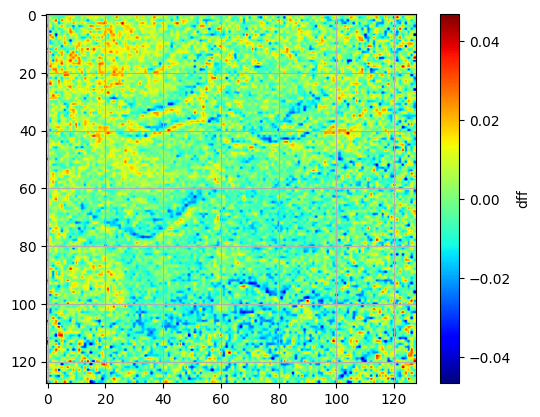

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:39,  3.19it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:37,  3.36it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:36,  3.38it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:38,  3.26it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:37,  3.29it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:36,  3.33it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:36,  3.33it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:38,  3.14it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:36,  3.22it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:36,  3.26it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:36,  3.23it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:35,  3.25it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:34,  3.30it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.24it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:33,  3.36it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:33,  3.33it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:32,  3.44it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:33,  3.32it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:33,  3.26it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:31,  3.40it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:30,  3.52it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:29,  3.64it/s]

 18%|██████████████▌                                                                  | 23/128 [00:06<00:30,  3.42it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:33,  3.12it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:33,  3.07it/s]

 20%|████████████████▍                                                                | 26/128 [00:07<00:33,  3.04it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:31,  3.16it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:32,  3.05it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:31,  3.16it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:30,  3.25it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:29,  3.31it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:30,  3.17it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:29,  3.23it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:28,  3.34it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:27,  3.43it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:27,  3.38it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:26,  3.43it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:25,  3.50it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:26,  3.40it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:26,  3.33it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:26,  3.33it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:25,  3.31it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:25,  3.30it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:24,  3.40it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:24,  3.42it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:13<00:24,  3.36it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:23,  3.49it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:23,  3.35it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:14<00:23,  3.38it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:24,  3.25it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.31it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:22,  3.38it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:15<00:21,  3.54it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:21,  3.40it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:20,  3.52it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:16<00:21,  3.32it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:22,  3.10it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:21,  3.25it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:17<00:20,  3.34it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:19,  3.43it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:20,  3.33it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:18<00:20,  3.29it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:18<00:19,  3.41it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:20,  3.14it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:19,  3.25it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:19<00:19,  3.26it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.34it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:17,  3.44it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:20<00:16,  3.51it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.31it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:17,  3.28it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:21<00:17,  3.14it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:17,  3.19it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:16,  3.23it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:22<00:16,  3.30it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:22<00:15,  3.38it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.26it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:23<00:15,  3.31it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:23<00:14,  3.44it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:14,  3.32it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:24<00:14,  3.33it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:24<00:13,  3.33it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:13,  3.26it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:13,  3.26it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:25<00:12,  3.37it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:25<00:12,  3.45it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:11,  3.56it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:26<00:12,  3.32it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:26<00:11,  3.30it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:11,  3.26it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:27<00:11,  3.21it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:27<00:11,  3.27it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.26it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:10,  3.27it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:28<00:10,  3.28it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:10,  3.14it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.24it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:29<00:08,  3.37it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:29<00:08,  3.41it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:08,  3.49it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:30<00:07,  3.57it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:30<00:07,  3.56it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.50it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:31<00:07,  3.37it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:31<00:06,  3.37it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:31<00:06,  3.34it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:32<00:06,  3.41it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:32<00:05,  3.54it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:32<00:05,  3.61it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:32<00:04,  3.67it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:33<00:04,  3.73it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:33<00:04,  3.45it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:33<00:04,  3.51it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:34<00:03,  3.52it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:34<00:03,  3.49it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:34<00:03,  3.59it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:34<00:03,  3.51it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:35<00:02,  3.56it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:35<00:02,  3.39it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:35<00:02,  3.35it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:36<00:02,  3.41it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:36<00:01,  3.32it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:36<00:01,  3.35it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:37<00:01,  3.41it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:37<00:00,  3.36it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:37<00:00,  3.26it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:37<00:00,  3.35it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.27it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.34it/s]

frame number 200 plotted


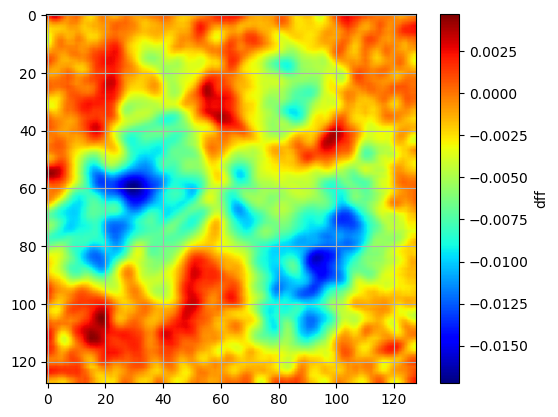

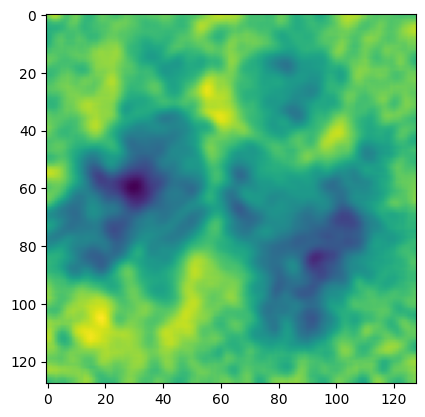

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 26


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 34
fail = 0
total trials = 34


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 9
fail = 31
total trials = 40


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 15
fail = 11
total trials = 26


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34362 [00:00<?, ?it/s]

  7%|█████▏                                                                    | 2430/34362 [00:00<00:01, 24067.80it/s]

 15%|███████████▎                                                              | 5254/34362 [00:00<00:01, 26363.19it/s]

 23%|████████████████▉                                                         | 7891/34362 [00:00<00:01, 22402.47it/s]

 30%|█████████████████████▋                                                   | 10191/34362 [00:00<00:01, 22297.37it/s]

 37%|██████████████████████████▊                                              | 12636/34362 [00:00<00:00, 22963.35it/s]

 44%|███████████████████████████████▊                                         | 14960/34362 [00:00<00:00, 21684.20it/s]

 51%|█████████████████████████████████████▎                                   | 17568/34362 [00:00<00:00, 22945.61it/s]

 58%|██████████████████████████████████████████▌                              | 20062/34362 [00:00<00:00, 23484.88it/s]

 66%|████████████████████████████████████████████████▏                        | 22666/34362 [00:00<00:00, 24193.21it/s]

 73%|█████████████████████████████████████████████████████▎                   | 25103/34362 [00:01<00:00, 24142.53it/s]

 80%|██████████████████████████████████████████████████████████▍              | 27529/34362 [00:01<00:00, 23894.58it/s]

 87%|███████████████████████████████████████████████████████████████▌         | 29927/34362 [00:01<00:00, 23851.60it/s]

 95%|█████████████████████████████████████████████████████████████████████▏   | 32585/34362 [00:01<00:00, 24627.34it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34362/34362 [00:01<00:00, 23655.61it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 24258.55it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 22230.31it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")